# The second part of the assignment, IDS 2021-2022
In this Jupyter notebook document all your results and the way you have obtained them. Please use the _Python environment_ provided for this part of the assignment. In addition to the _Jupyter notebook_, please submit _one zip-file_ containing  other outputs you have generated that are not included in this notebook (such as pdf, jpg, and others). Please make sure that the other outputs are easily identifiable, i.e. use names as requested in the corresponding question. _You do not need to include the datasets._

This is the _only_ submission that is required (Jupyter notebook + zip-file). A separate report is _not_ needed and will not be considered for grading. 

Give your commented Python code and answers in the corresponding provided cells. Make sure to answer all questions in a clear and explicit manner and discuss your outputs. _Please do not change the general structure of this notebook_. You can, however, add additional markdown or code cells if necessary. <b>Please DO NOT CLEAR THE OUTPUT of the notebook you are submitting! </b>

<font color="red"> Please make sure to include the names and matriculation numbers of all group members in the slot provided below. </font> If a name or a student id is missing, the student will not receive any points.

<font color="red">Plan your time wisely. </font> A few parts of this assignment might take some time to run. It might be necessary to consider time management when you plan your group work.

Hint: RWTHmoodle allows multiple submissions, with every new submission overwriting the previous one. <b>Partial submissions are therefore possible and encouraged. </b> This might be helpful in case of technical issues with RWTHMoodle, which may occur close to the deadline.


<font color="red"><b>Student Names and IDs:
    
    1. Cedric Becks 378329
    
    2. Gonzalo Martin Garcia 377031
    
    3. Alberto Grimaldi 433017


# Setup

In [1]:
### Display
from IPython.core.display import display, HTML

### Widgets
#import ipywidgets as widgets

### Data Handline
import pandas as pd
import numpy as np

### Utility
import math
import string
import datetime
import pickle

### Plotting
# Matplotlib
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import cm
# Matplotlib toolkits
from mpl_toolkits.axes_grid1 import make_axes_locatable
# Seaborn
import seaborn as sns
# Plotly
import plotly.graph_objects as go
# Gespatial data with cartopy
import cartopy.crs as ccrs
import cartopy.feature as cfeature

### Sklearn
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.impute import KNNImputer
from sklearn.pipeline import Pipeline
from sklearn.linear_model import SGDClassifier
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.model_selection import train_test_split


### Frequent Pattern Mining
from mlxtend.frequent_patterns import apriori
from mlxtend.frequent_patterns import fpgrowth
from mlxtend.frequent_patterns import association_rules as arule

### Text Mining
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import sent_tokenize
from nltk.stem.snowball import SnowballStemmer
from nltk.stem import WordNetLemmatizer
from nltk.lm.preprocessing import padded_everygram_pipeline
from nltk.lm import MLE
from gensim.models.doc2vec import Doc2Vec, TaggedDocument

### PM4Py
import pm4py
# Log Handling
from pm4py.objects.conversion.log import converter as log_converter
# Statistics
from pm4py.statistics.traces.generic.log import case_statistics
# Filtering
from pm4py.algo.filtering.log.variants import variants_filter
from pm4py.algo.filtering.log.attributes import attributes_filter
# Discovery and Conformance Checking
from pm4py.algo.evaluation.replay_fitness import algorithm as replay_fitness_evaluator
from pm4py.objects.conversion.process_tree import converter as pt_converter
# Visualization
from pm4py.visualization.process_tree import visualizer as pt_visualizer
from pm4py.visualization.petri_net import visualizer as pn_visualizer

/home/hydrabogen/.local/share/anaconda3/envs/IDS20212/lib/python3.8/site-packages/gensim/similarities/__init__.py:15: UserWarning: The gensim.similarities.levenshtein submodule is disabled, because the optional Levenshtein package <https://pypi.org/project/python-Levenshtein/> is unavailable. Install Levenhstein (e.g. `pip install python-Levenshtein`) to suppress this warning.
  warnings.warn(msg)


In [2]:
# Pandas indexing
idx = pd.IndexSlice

# Display() configuration options
pd.set_option('display.max_columns', 38)
plt.rcParams['figure.figsize'] = [40, 20]
sns.set(rc={'figure.figsize':(40,20)})


In [3]:
# Download all if not already done so
nltk.download()

showing info https://raw.githubusercontent.com/nltk/nltk_data/gh-pages/index.xml


True

Be careful if you use the **matplotlib widget** magic. If you do not close the created plots, previous plots may change if you create a new one.
So if you use this magic command, be careful about your outputs in your final submission.

In [4]:
#%matplotlib inline

# Q1 - Preprocessing (20 points)
In this question, we consider a US-census dataset (**census_data.csv**).
Each row contains statistics of a certain tract on a variety of, particularly income- and work-related, life aspects of US citizens.
Short column description:

| Column | Description |
| ------ | ----------- |
| CensusTract | Tract |
| State | State |
| County | County |
| TotalPop | Total population  |
| Men | Number of men |
| Women | Number of women |
| Hispanic, White, Black, Native, Asian, Pacific | Percentage of ethnic group |
| Citizen | Percentage of citizen |
| Income | Median household income |
| IncomePerCap | Income per capita |
| Poverty | Poverty rate |
| ChildPoverty | Child poverty rate |
| Professional | Employed in management, business, science, and arts (percentage) |
| Service, Office, Construction, Production | Other profession fields (percentage) |
| PrivateWork, PublicWork | Employed in private / public sector (percentage) |
| Drive, Carpool, Transit, Walk, OtherTransp | Means of commuting (percentage) |
| WorkAtHome | Working at home (percentage) |
| MeanCommute | Mean time for commuting |
| Employed | Number of employed |
| SelfEmployed | Self-employed (percentage) |
| FamilyWork | Unpaid family work (percentage) |
| Unemployment | Unemployment rate |


## Loading the Data and Initial Quality Investigation

**a)** Load the dataset into a dataframe `df`. <font color='red'>Use the CensusTract as index for your dataframe</font>. In doing so, ensure that the index is valid, that is, it does not contain any duplicate entries.

**In the subsequent questions, only modify the dataframe `df` if explicitly requested. However, you can always create working copies.**

In [5]:
df = pd.read_csv("./dataset/census_data.csv", sep=",", index_col="CensusTract", on_bad_lines="warn")
display(df.index.is_unique)

True

**b)** Show the data types of the dataframe columns as well as the first few rows. On the first sight, are there any data type problems (e.g., numerical columns having a non-numerical data type)? 

In [6]:
display(df.dtypes.to_frame().T)
display(df.head(20))

,State,County,TotalPop,Men,Women,Hispanic,White,Black,Native,Asian,Pacific,Citizen,Income,IncomePerCap,Poverty,ChildPoverty,Professional,Service,Office,Construction,Production,Drive,Carpool,Transit,Walk,OtherTransp,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment
0,object,object,int64,float64,float64,float64,float64,float64,float64,float64,float64,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,int64,float64,float64,float64,float64,float64


,State,County,TotalPop,Men,Women,Hispanic,White,Black,Native,Asian,Pacific,Citizen,Income,IncomePerCap,Poverty,ChildPoverty,Professional,Service,Office,Construction,Production,Drive,Carpool,Transit,Walk,OtherTransp,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment
CensusTract,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1001020100,Alabama,Autauga,1948,940.0,1008.0,0.9,87.4,7.7,0.3,0.6,0.0,1503,61838.0,25713.0,8.1,8.4,34.7,17.0,21.3,11.9,15.2,90.2,4.8,0.0,0.5,2.3,2.1,25.0,943,77.1,18.3,4.6,0.0,5.4
1001020200,Alabama,Autauga,2156,1059.0,1097.0,0.8,40.4,53.3,0.0,2.3,0.0,1662,32303.0,18021.0,25.5,40.3,22.3,24.7,21.5,9.4,22.0,86.3,13.1,0.0,0.0,0.7,0.0,23.4,753,77.0,16.9,6.1,0.0,13.3
1001020300,Alabama,Autauga,2968,1364.0,1604.0,0.0,74.5,18.6,0.5,1.4,0.3,2335,44922.0,20689.0,12.7,19.7,31.4,24.9,22.1,9.2,12.4,94.8,2.8,0.0,0.0,0.0,2.5,19.6,1373,64.1,23.6,12.3,0.0,6.2
1001020400,Alabama,Autauga,4423,2172.0,2251.0,10.5,82.8,3.7,1.6,0.0,0.0,3306,54329.0,24125.0,2.1,1.6,27.0,20.8,27.0,8.7,16.4,86.6,9.1,0.0,0.0,2.6,1.6,25.3,1782,75.7,21.2,3.1,0.0,10.8
1001020500,Alabama,Autauga,10763,4922.0,5841.0,0.7,68.5,24.8,0.0,3.8,0.0,7666,51965.0,27526.0,11.4,17.5,49.6,14.2,18.2,2.1,15.8,88.0,10.5,0.0,0.0,0.6,0.9,24.8,5037,67.1,27.6,5.3,0.0,4.2
1001020600,Alabama,Autauga,3851,1787.0,2064.0,13.1,72.9,11.9,0.0,0.0,0.0,2642,63092.0,30480.0,14.4,21.9,24.2,17.5,35.4,7.9,14.9,82.7,6.9,0.0,0.0,6.0,4.5,19.8,1560,79.4,14.7,5.8,0.0,10.9
1001020700,Alabama,Autauga,2761,1210.0,1551.0,3.8,74.5,19.7,0.0,0.0,0.0,2060,34821.0,20442.0,28.9,41.9,19.5,29.6,25.3,10.1,15.5,92.4,7.6,0.0,0.0,0.0,0.0,20.0,1166,82.0,14.6,3.4,0.0,11.4
1001020801,Alabama,Autauga,3187,1502.0,1685.0,1.3,84.0,10.7,3.1,0.0,0.0,2391,73728.0,32813.0,13.0,25.9,42.8,10.7,34.2,5.5,6.8,84.3,8.1,0.0,0.0,1.7,5.9,24.3,1502,78.1,14.8,7.1,0.0,8.2
1001020802,Alabama,Autauga,10915,5486.0,5429.0,1.4,89.5,8.4,0.0,0.0,0.0,7778,60063.0,24028.0,13.9,18.3,31.5,17.5,26.1,7.8,17.1,90.1,8.6,0.0,0.0,0.0,1.3,29.4,4348,73.3,22.1,4.6,0.0,8.7


*Your markdown for your discussion.*

<font color='orange'>
    Because the attributes 'Men' and 'Woman' describe absolute quantities, the data types of their columns should clearly be int64, but are float64 instead. Similarly, 'Income' and 'IncomePerCap' should also be int64 since it seems that income is rounded (up or down) in this dataset (which is not clear without domain knowledge).
    Looking at these attributes (Men, Woman, Income, and IncomePerCap) in the CSV file, one can see that there exist instances with empty/missing cells (i.e. NaN default values). Hence, to represent these empty cells as a NaN value, when reading the dataset as a data frame, these 4 attributes were given the data type float64. 
Other than these four cases, the remaining data types are fine.
</font>

**c)** To improve performance and memory usage (in particular for large datasets) it is important to use **categorical** columns whenever suitable. 
Are there any categorical column candidates? Explain your answer. \
Afterwards, convert these columns into categorical columns.

In [7]:
df['State'] = df['State'].astype('category')
df['County'] = df['County'].astype('category')
display(df.dtypes.to_frame().T)

,State,County,TotalPop,Men,Women,Hispanic,White,Black,Native,Asian,Pacific,Citizen,Income,IncomePerCap,Poverty,ChildPoverty,Professional,Service,Office,Construction,Production,Drive,Carpool,Transit,Walk,OtherTransp,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment
0,category,category,int64,float64,float64,float64,float64,float64,float64,float64,float64,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,int64,float64,float64,float64,float64,float64


*Your markdown for your discussion.*

<font color='orange'>
Most of the columns in this dataset are numerical. The only two which are not are the first two data columns, 'County' and 'State'. Only these two can be taken into consideration for categorization without losing information. 
</font>

**d)** To select a good strategy to deal with missing data, it is important to get an overview over the general data distribution.
Show the basic statistics for the dataset and create 6 boxplots for the following column groupings:

    ['TotalPop', 'Men', 'Women', 'Citizen', 'Employed'],
    ['Income', 'IncomePerCap'],
    ['Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific'],
    ['PrivateWork', 'PublicWork', 'SelfEmployed', 'FamilyWork', 'Unemployment', 'Poverty', 'ChildPoverty'],
    ['Professional', 'Service', 'Office', 'Construction', 'Production', 'Drive', 'Carpool', 'Transit', 'Walk', 'OtherTransp', 'WorkAtHome'],
    ['MeanCommute']

Can you spot any (severe) data quality problems, in particular, are there unrealistic values (also considering the semantics)?

*Hint: Use the `df.describe()` function.*

In [8]:
# Display basic statistical features for all attributes
display(df.shape[0]) # Number of rows
display(df.describe())

74001

,TotalPop,Men,Women,Hispanic,White,Black,Native,Asian,Pacific,Citizen,Income,IncomePerCap,Poverty,ChildPoverty,Professional,Service,Office,Construction,Production,Drive,Carpool,Transit,Walk,OtherTransp,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment
count,74001.000000,73622.000000,73640.000000,73311.000000,73311.000000,73311.000000,73311.000000,73311.000000,73311.000000,74001.000000,72901.000000,73261.000000,73166.000000,72883.000000,73194.000000,73194.000000,73194.000000,73194.000000,73194.000000,73204.000000,73204.000000,73204.000000,73204.000000,73204.000000,73204.000000,73052.000000,74001.000000,73194.000000,73194.000000,73194.000000,73194.000000,73199.000000
mean,4325.591465,2127.937437,2197.755337,16.862810,62.032106,13.272581,0.727726,4.588253,0.145012,3043.079566,57225.564862,28491.234299,16.958020,22.486827,34.798843,19.101381,23.951559,9.292337,12.856005,75.533887,9.627468,5.456050,3.123340,1.891606,4.368093,25.667357,1983.907366,78.975238,14.621566,6.233814,0.169772,9.028663
std,2129.306903,1072.200320,1095.899964,22.940695,30.684152,21.762483,4.488340,8.794003,1.037354,1475.492946,28663.331962,15047.068660,13.196518,19.190909,15.007075,8.279143,5.957279,6.023290,7.671588,15.371620,5.367321,11.724287,5.881237,2.596198,3.904990,6.964881,1073.429808,8.345758,7.535786,4.042990,0.458227,5.955441
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2611.000000,128.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.200000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2891.000000,1409.000000,1460.000000,2.400000,39.400000,0.700000,0.000000,0.200000,0.000000,2037.000000,37683.000000,19123.000000,7.200000,7.000000,24.100000,13.400000,20.100000,5.000000,7.100000,72.000000,6.000000,0.000000,0.400000,0.400000,1.800000,20.800000,1249.000000,74.600000,9.600000,3.500000,0.000000,5.100000
50%,4063.000000,1987.000000,2066.000000,7.000000,71.400000,3.700000,0.000000,1.400000,0.000000,2863.000000,51094.000000,25344.000000,13.400000,17.800000,32.600000,17.900000,23.800000,8.400000,11.800000,79.700000,8.800000,1.100000,1.400000,1.100000,3.500000,25.000000,1846.000000,80.100000,13.400000,5.500000,0.000000,7.700000
75%,5442.000000,2674.000000,2774.000000,20.400000,88.300000,14.400000,0.400000,4.800000,0.000000,3838.000000,70117.000000,33894.000000,23.100000,33.800000,43.875000,23.600000,27.500000,12.500000,17.400000,84.900000,12.300000,4.700000,3.500000,2.500000,5.900000,29.800000,2553.000000,84.600000,18.200000,8.100000,0.000000,11.400000
max,53812.000000,27962.000000,27250.000000,100.000000,100.000000,100.000000,100.000000,91.300000,84.700000,37416.000000,248750.000000,254204.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,80.000000,24075.000000,100.000000,100.000000,100.000000,26.500000,100.000000


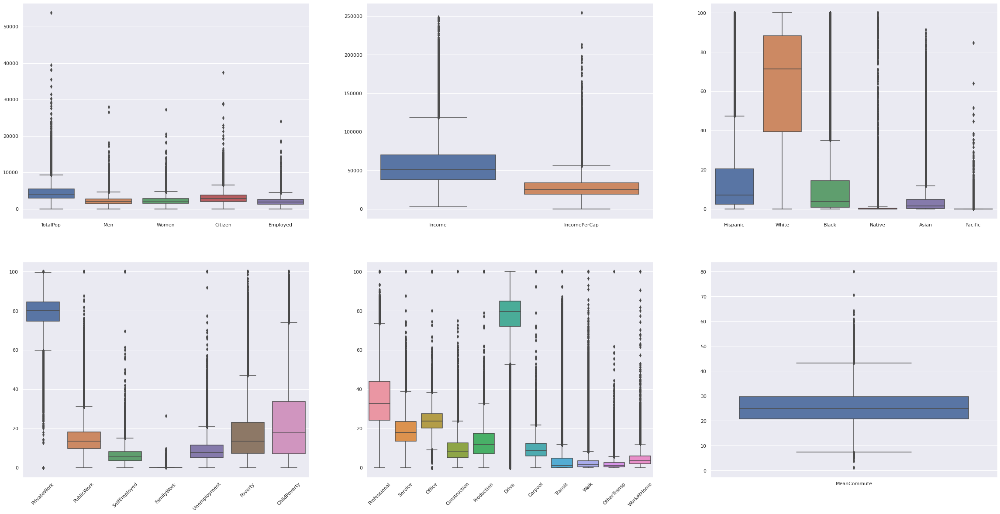

In [9]:
# Create and display the 6 boxplots
fig, axs = plt.subplots(2,3)
sns.boxplot(ax=axs[0,0], data=df[['TotalPop', 'Men', 'Women', 'Citizen', 'Employed']])
sns.boxplot(ax=axs[0,1], data=df[['Income', 'IncomePerCap']])
sns.boxplot(ax=axs[0,2], data=df[['Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific']])
sns.boxplot(ax=axs[1,0], data=df[['PrivateWork', 'PublicWork', 'SelfEmployed', 'FamilyWork', 'Unemployment', 'Poverty', 'ChildPoverty']]).set_xticklabels(rotation=45, labels=['PrivateWork', 'PublicWork', 'SelfEmployed', 'FamilyWork', 'Unemployment', 'Poverty', 'ChildPoverty'])
sns.boxplot(ax=axs[1,1], data=df[['Professional', 'Service', 'Office', 'Construction', 'Production', 'Drive', 'Carpool', 'Transit', 'Walk', 'OtherTransp', 'WorkAtHome']]).set_xticklabels(rotation=45, labels=['Professional', 'Service', 'Office', 'Construction', 'Production', 'Drive', 'Carpool', 'Transit', 'Walk', 'OtherTransp', 'WorkAtHome'])
sns.boxplot(ax=axs[1,2], data=df[['MeanCommute']])

display()

*Your markdown for your discussion.*

<font color='orange'>
    First, we can focus on the feature count. It computes the number of non-missing instances for each attribute. Here, we can see that the attributes TotalPop, Citizen, and Employed have no missing values since the dataset contains 74001 examples. Also important to note is how some groups of attributes have the same count, indicating that if for a given example one of these attributes is missing, most likely the other attributes in the group are also missing. This can be verified by looking at the CSV dataset. This is the case for groups of the same context: [Professional, Service, Office, Construction, Production], [Hispanic, White, Black, Native, Asian, Pacific] and [PrivateWork, PublicWork, SelfEmployed, FamilyWork]. Notice that for similar groupings we have created the boxplots above. Child poverty seems to be the most affected attribute when it comes to missing values (missing 1118 instances).
    Knowing that a lot of attributes are given as percentage values (ex. Poverty, ChildPoverty, Professional, ...) their minimum and maximum are 0 and 100. However, these are unrealistic or statistically very improbable values, where an observed county has 100% Child poverty or ex. everyone works in office, etc. The attribute IncomePerCap appears to record the income w.r.t population for a full year. Therefore, the minimum of 128$ also seems unrealistic.
</font>

## Handling Missing Values
(In the following task you can assume that every NAN entry in the dataframe is actually a missing value. This can paritally be justified by the fact that pandas did not have problems inferring the "proper" datatypes (e.g., numbers types as string would result in an object column) and your subsequent check of the data types. Therefore, you can use `df.isna()` as a proxy indicator for missing values.)

**e)** Simply filling missing entries is usually not a good idea. Therefore, you should first analyze the quantity of missing values and check for patterns of missing values.

To this end, compute the following statistics on missing values:
1) How many entries does the dataframe have? (To relate this to the number of entries missing)
2) How many missing values do we have?
3) How many rows have at least a single missing value?
4) Count the number of missing values per column.
5) Count the number of missing values per row and aggregate them - i.e., show the number of rows that suffer from x missing values.

What do you observe?

In [10]:
data = []
# Number of entries (i.e. rows x cols)
data += [df.size]

# Number of missing entries
data += [df.isna().sum().sum()]

# Number of diry rows
data += [df.isna().max(axis=1).sum()]
display(pd.DataFrame(data=[data], columns=["Entries", "Missing Entries", "Dirty Rows"], index=[""]))

# Number of missing values per column
display(df.isna().sum().to_frame(name="").T)

# Number of rows missing X values
display(df.isna().sum(axis=1).to_frame("# Missing Entries").groupby("# Missing Entries").size().to_frame(name="").T)


,Entries,Missing Entries,Dirty Rows
,2516034,22469,2008


,State,County,TotalPop,Men,Women,Hispanic,White,Black,Native,Asian,Pacific,Citizen,Income,IncomePerCap,Poverty,ChildPoverty,Professional,Service,Office,Construction,Production,Drive,Carpool,Transit,Walk,OtherTransp,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment
,0,0,0,379,361,690,690,690,690,690,690,0,1100,740,835,1118,807,807,807,807,807,797,797,797,797,797,797,949,0,807,807,807,807,802


# Missing Entries,0,1,2,3,4,5,9,12,13,14,16,18,19,20,21,27
,71993,982,91,93,32,2,1,1,8,2,1,4,7,90,4,690


*Your markdown for your discussion.*

<font color='orange'>
    The data frame has 2516034 entries in total, of which 22469 entries are missing and 2008 rows have at least a single missing value. The number of missing values per column can be seen above. ChildPoverty contains the most missing values. The number of aggregated missing values per row can also be seen above.
When looking at the number of missing values per column, as previously mentioned, attributes of the same context have the same number of missing values and hence, tend to be missing together : [Hispanic, White, Black, Native, Asian, Pacific], [Professional, Service, Office, Construction, Production], [Drive, Carpool, Transit, Walk, OtherTransp] and [PrivateWork, PublicWork, SelfEmployed, FamilyWork, Unemployment].
    If we want to fill in the missing values, we can focus on these groups separately and try to find a solution based on the context of their attributes.
</font>

**f)** We decide to **remove all rows from `df` where the total population is zero**. \
Given the preceding results, how do you evaluate this strategy? Try to motivate your argumentation by additional short analysis results (see hint for an inspiration).

*Hint: It might be interesting to have a look at the rows with zero population. Afterwards, you can provide some analysis results that show that your (potential) observation generalizes to all rows with zero population.*

In [11]:
# Display all examples with a total population of zero
display(df[df["TotalPop"] == 0])
print('Number of examples with total population zero: ', len(df[df["TotalPop"] == 0]))

# Remove all examples with a total population of zero
df = df[df["TotalPop"] != 0]

,State,County,TotalPop,Men,Women,Hispanic,White,Black,Native,Asian,Pacific,Citizen,Income,IncomePerCap,Poverty,ChildPoverty,Professional,Service,Office,Construction,Production,Drive,Carpool,Transit,Walk,OtherTransp,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment
CensusTract,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1003990000,Alabama,Baldwin,0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN
1015981902,Alabama,Calhoun,0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN
1015981903,Alabama,Calhoun,0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN
1097990000,Alabama,Mobile,0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN
1117980000,Alabama,Shelby,0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72137990000,Puerto Rico,Toa Baja,0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN
72143990000,Puerto Rico,Vega Alta,0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN
72145990000,Puerto Rico,Vega Baja,0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN


Number of examples with total population zero:  690


*Your markdown for your discussion.*

<font color='orange'>
    We know that in the whole dataset there are 690 instances that are missing 27 entries (remember that State, County, TotalPop, Citizen, and Employed are always defined with default value 0). It just so happens that these 690 examples are exactly all examples where the total population is 0. Hence, the strategy of removing them is correct. Intuitively it also makes sense, since the dataset is a census tract, and if there are no people in the region no census can be taken.
</font>

## Imputing Missing Values

**g)** The previous analysis showed that there are missing values in the 'Men' and 'Women' columns.\
How would you impute these values? \
Motivate your approach and apply it to `df`.

*Hint: Do not forget about the semantics of the columns.*

In [12]:
# The numbers for missing values in men and women are different, which implies atleast some of the missing values can 
# be restored by computing "Women = TotalPop - Men" and vice versa.
# Here we are somewhat lucky, as that seems to be the case every time. We do not need to deal with rows where both Men
#and Women are NaN at the same time.
df.loc[df["Men"].isna(), ["Men"]] = df[df["Men"].isna()]["TotalPop"] - df[df["Men"].isna()]["Women"]
df.loc[df["Women"].isna(), ["Women"]] = df[df["Women"].isna()]["TotalPop"] - df[df["Women"].isna()]["Men"]

In [13]:
assert df[['Men', 'Women']].isna().sum().sum() == 0

**h)** Finally, impute the remaining missing values in `df` using the knn-imputation method.

1) Before you impute the remaining missing values, you should improve the data semantics consistency by turning the columns 
    
        ['Men', 'Women', 'Citizen', 'Employed']
    
    into percentage scores as well. To this end, divide these values by the total population (i.e., 'TotalPop')

In [14]:
# Normalizing these attributes
df.loc[:, ["Men"]] = df["Men"]/df["TotalPop"]
df.loc[:, ["Women"]] = df["Women"]/df["TotalPop"]
df.loc[:, ["Citizen"]] = df["Citizen"]/df["TotalPop"]
df.loc[:, ["Employed"]] = df["Employed"]/df["TotalPop"]

2) Impute the missing values using the knn-imputation method.
    To this end, apply the following steps:
        1) Create a working copy `df_tmp` of your dataframe.
        2) Drop the columns `['State', 'County']` from `df_tmp`. On the one hand, this makes the following steps easier because we only have to deal with numerical columns; on the other hand, an alternative one-hot encoding is also problematic as this will cause our feature dimensionality to explode!
        3) Normalize the data in `df_tmp` (e.g., Standard score normalization). If the features have very different scales, even though we are mostly using percentages, knn can become very biased.
        4) Impute the missing values considering five neighbors.
        5) Invert the transformation applied upfront to enable more meaningful and intuitive visualizations.
        6) Append the columns `['State', 'County']`
 
In the end, `df` should not contain missing values and have columns `['State', 'County']`.

*Hint: Be careful with the indices of your dataframes.*


In [15]:
df_temp = df.copy()
df_temp = df_temp.drop(labels=["State", "County"], axis=1)

In [16]:
sc = StandardScaler()
df_temp = pd.DataFrame(sc.fit_transform(df_temp), columns=df_temp.columns, index=df.index)

In [17]:
knn = KNNImputer(missing_values=np.nan, n_neighbors=5)
df_temp = pd.DataFrame(knn.fit_transform(df_temp), columns=df_temp.columns, index=df.index)

In [18]:
df_temp = pd.DataFrame(sc.inverse_transform(df_temp), columns=df_temp.columns, index=df.index)

In [19]:
df_temp.insert(0, "County", df["County"])
df_temp.insert(0, "State", df["State"])
df = df_temp

In [20]:
assert 'State' in df.columns
assert 'County' in df.columns
assert df.isna().sum().sum() == 0
assert df['Hispanic'].min() > -0.01
assert df['Hispanic'].max() < 101

## Data Integration

**i)** In the final preprocessing step, you should integrate one additional source of data into the preprocessed dataframe `df`. 
As the data has a natural geospatial dimension, you are going to endow each tract with its geographic coordinate.
To this end, load **coordinates.csv**. Integrate the two data sources exploiting the correspondence between 'CensusTract' and 'GEOID'.
Finally, drop the 'USPS' column.

In [21]:
cf = pd.read_csv("./dataset/coordinates.csv", index_col="GEOID")
df.loc[:,["INTPTLONG", "INTPTLAT"]] = cf[["INTPTLONG", "INTPTLAT"]]

In [22]:
assert 'Men' in df.columns
assert 'County' in df.columns
assert 'INTPTLONG' in df.columns
assert 'INTPTLAT' in df.columns

# Q2 - Visualization (15 points)
In this task, you will analyze the data that you preprocessed in question 1 (**census_data.csv**). In particular you will analyze income-related aspects, using different means of visualization.

Start with the following preprocessed and integrated dataframe `df`. \
Note that it has a similar structure to the dataframe that you should obtain from the previous task, however, the values have been modified!

**Library usage:** This notebook imports a couple visualization libraries that have a significat overlap in terms of functionalities. Therefore, you are free to use any of these libraries (and those in the environment in general) to implement the following questions as long as your resulting plot compilies with the explicitly mentioned requirements.

In [23]:
df = pd.read_pickle('./dataset/df_vis.pkl')

**a)** Visualize two histograms for 'Income' and 'IncomePerCap' in a **single plot**. Compare the two distributions; what do you observe?

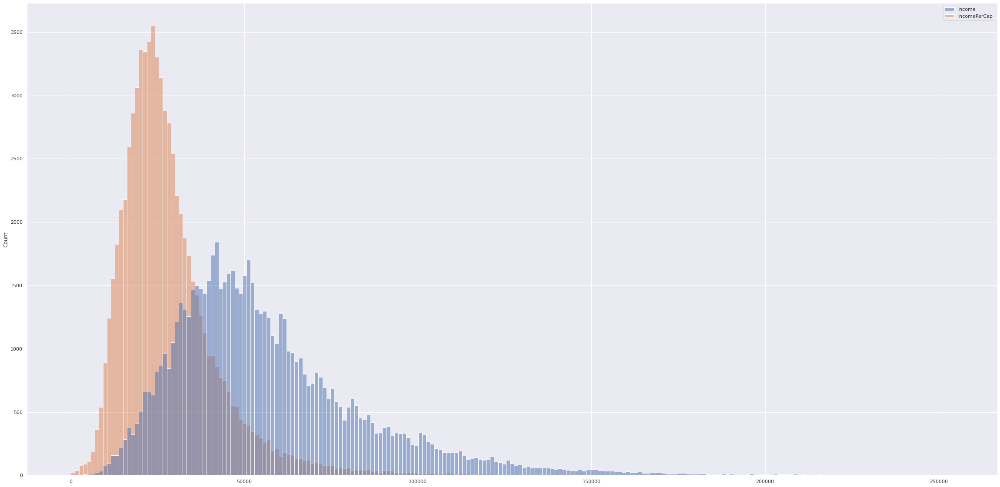

In [24]:
sns.histplot(data=df[['Income', 'IncomePerCap']])
display()

*Your markdown for your discussion.*
<font color='orange'>
Both cases seem to be generated by a (non-normalized) gamma distribution with different scale and shape parameters. The shape parameter has to be bigger than 1 to make somewhat of a bell form. Moreover, the rate at which IncomePerCap decreases is faster compared to the rate of Income. Hence, IncomePerCap has a higher scale parameter than the Income distribution.
     The income per capita describes the income w.r.t its population. As a result income deviations from the mean (high and low earners) are tamed/(loose significance) through averaging. This creates a more uniformly concentrated body which can be seen in the income per capita distribution. Additionally, averaging returns smaller incomes which move the distribution near zero.
    Often one focuses more on IncomePerCap when assessing the wealth of a certain region for an outlier to not skew the general state of its people. 
</font>

## Aggregation for Visualization Pruposes
**b)** As the data contains too many rows for per-row visualizations, you should aggregate the data further before creating more interesting visualizations.
The following function will do the job for your; however, why didn't we simply run `groupby(...).mean()` to get the results for the columns
specified in `l_col`?

In [25]:
def my_aggregation(df):
    l_col = ['Men', 'Women', 'Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific', 'Citizen', 'Income', 'IncomePerCap', 
             'Poverty', 'ChildPoverty', 'Professional', 'Service', 'Office', 'Construction', 'Production', 'Drive', 'Carpool', 
             'Transit', 'Walk', 'OtherTransp', 'WorkAtHome', 'MeanCommute', 'Employed', 'PrivateWork', 'PublicWork', 'SelfEmployed', 
             'FamilyWork', 'Unemployment', 'INTPTLAT', 'INTPTLONG']
    df_tmp = df.copy()
    df_tmp.loc[idx[:, l_col]] = df_tmp.loc[idx[:, l_col]].mul(df_tmp['TotalPop'], axis=0)
    df_tmp = df_tmp.groupby(['State', 'County'], observed=True).sum()
    df_tmp.loc[idx[:, l_col]] = df_tmp.loc[idx[:, l_col]].div(df_tmp['TotalPop'], axis=0)
    
    return df_tmp


In [26]:
# Update data frame
df = my_aggregation(df)

*Your markdown for your discussion.*

<font color='orange'>
     When simply grouping certain attribution which are represented as percentages (ethnicities, men and women) would not be normalized anymore, i.e. their sum may not yield 100%.
</font>

**c)** Next, you should create an overview over column correlations particularly consideirng high/medium/and low incomes.

1) Create a copy `df_plot` of the aggregated dataframe.

In [27]:
df_plot = df.copy()

2) Append a column 'IncomeClass' to `df_plot` containing the 'Income' categories based on the following inter-percentile ranges:
    - low' iff the income is less than the 33% income percentile
    - 'medium' if the income is between the 33% and 66% percentile, and 
    - 'high' iff the income is above the 66% percentile

In [28]:
df_plot.loc[idx[:, "IncomeClass"]] = pd.cut(df_plot["Income"], 3, include_lowest=True, labels=["low", "medium", "high"]).astype('category')

3) Project the dataframe on the columns that contain percent values (for the sake of readability), that is:

        ['Men', 'Women', 'Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific', 'Poverty', 'ChildPoverty', 
        'Professional', 'Service', 'Office', 'Construction', 'Production',
        'Drive', 'Carpool', 'Transit', 'Walk', 'OtherTransp', 'WorkAtHome',
        'MeanCommute', 'Employed', 'PrivateWork', 'PublicWork', 'SelfEmployed',
        'FamilyWork', 'Unemployment', 'IncomeClass']
        

In [29]:
df_plot = df_plot[['Men', 'Women', 'Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific', 'Poverty', 'ChildPoverty', 
        'Professional', 'Service', 'Office', 'Construction', 'Production',
        'Drive', 'Carpool', 'Transit', 'Walk', 'OtherTransp', 'WorkAtHome',
        'MeanCommute', 'Employed', 'PrivateWork', 'PublicWork', 'SelfEmployed',
        'FamilyWork', 'Unemployment', 'IncomeClass']]

4) Create a parallel coordinates diagram that uses the 'IncomeClass' for coloring the lines. Rotate the x-axis labels by 90° to make them easier to read.
Briefly discuss your results. Do you observe any correlations? Please explain.
    

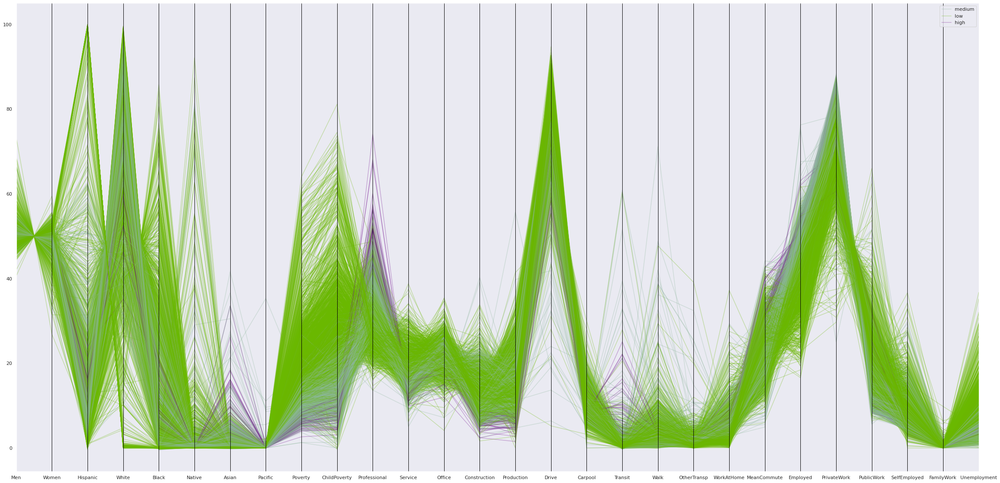

In [30]:
pd.plotting.parallel_coordinates(df_plot, "IncomeClass", alpha=0.3)
display()

<font color='orange'>
    From this parallel coordinates diagram, we can see that there is no clear/strong correlation between income and gender distributions. There is however a strong negative correlation between income and non-white ethnic concentrations, which may depict income inequality for minorities. As one would expect, there is a strong positive correlation between professional Jobs and income, and a strong negative correlation between income and poverty and unemployment. At last but not least a correlation is also visible between income and average transit time. For this case, there is no obvious explanation for the correlation, since there are jobs that require a lot and no transit which also have a high income.
</font>

## Advanced Visualization: Map

**d)** In this task, you are going to create an advanced visualization that exploits the geospatial nature of the data, that is, you will project the average 'Income' of each county and its population onto a map of the USA. \
You can use the following code to create a suitable map extend.

    ax.set_extent([-125, -66.5, 20, 50], ...)
        
Given this instance, plot one marker (e.g., circular marker) for each row in our aggregated dataset onto the map.
The color encoding should show the average 'Income' of the corresponding county, while the size should be chosen according to its population ('TotalPop'). If you want to modify the dataframe, create a **working copy** beforehand.

What do you observe?


/tmp/ipykernel_83304/162602949.py:20: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cb = plt.colorbar(cm.ScalarMappable(cmap=colors), )
/tmp/ipykernel_83304/162602949.py:21: UserWarning: FixedFormatter should only be used together with FixedLocator
  cb.ax.set_yticklabels(["poor", "", "","", "", "rich"])


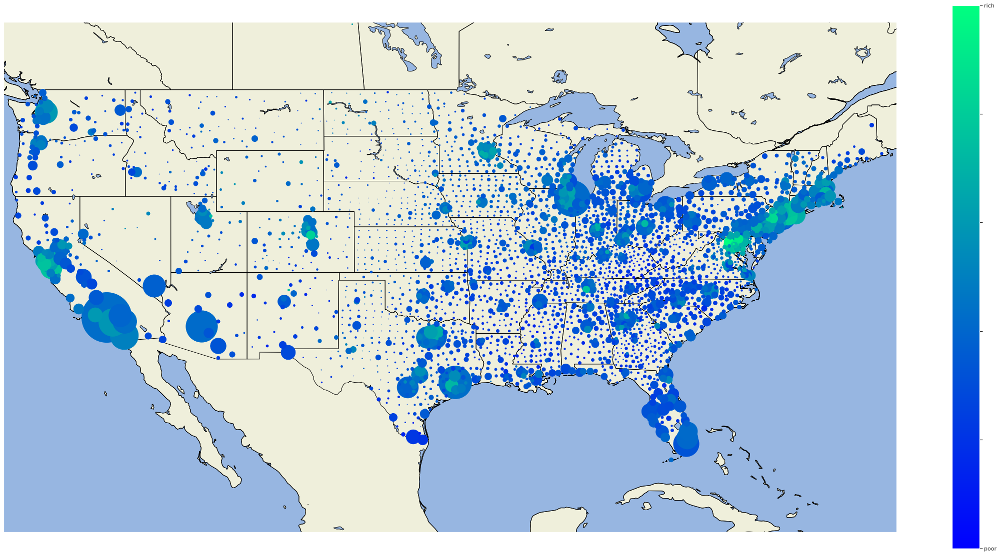

In [31]:
df_map = df.copy()
df_map = df_map[['TotalPop', 'Income', 'INTPTLONG', 'INTPTLAT']]
sc = MinMaxScaler()

# We decide the size of each dot. Because the radius has a quadratic impact on the size of each dot, we first normalize the area by taking the squareroot of every datapoint in 'TotalPop'
# This also ensures that the natural interpretation of the dot-size is consistent with our human expectation of comparing area instead of radius.
df_map.loc[idx[:, ["TotalPop"]]] = sc.fit_transform(np.sqrt(df_map[['TotalPop']])) * 200

# Similarly, we scale income between 0 and 1 to be able to project a colormap onto our cities.
df_map.loc[idx[:, ["Income"]]] = sc.fit_transform(df_map[['Income']]) 

# Lastly, we make sure the bigger cities dont overlay the smaller ones by drawing them first.
df_map = df_map.sort_values("TotalPop", ascending=False)

# For the colormap, we decided on Blue -> Green, with blue being poor and green being rich
colors = cm.get_cmap("winter")

# We use cartopy in conjunction with matplotlib to draw everything.
ax = plt.axes(projection=ccrs.PlateCarree())
cb = plt.colorbar(cm.ScalarMappable(cmap=colors), )
cb.ax.set_yticklabels(["poor", "", "","", "", "rich"])
ax.coastlines()
ax.add_feature(cfeature.STATES)
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.LAND, edgecolor='black')
ax.add_feature(cfeature.LAKES, edgecolor='black')
ax.set_extent([-125, -66.5, 20, 50])

for county in df_map.index:
    vals = df_map.loc[county]
    ax.plot(vals["INTPTLONG"], vals["INTPTLAT"], c=colors(vals["Income"]), marker=".", markersize=vals["TotalPop"], zorder=50, transform=ccrs.PlateCarree())

*Your markdown for your discussion.*

<font color='orange'>
    With this map can see the population density of the USA. At first glance, it is noticeable how the USA is a sparsely populated country. Generally, the south, midwest, and northeast are more uniformly populated and richer than the north and southwest. Moreover, the highest population concentrations can be found in the cost. The richest densities are on the east and west coasts, more specifically in the state of new york, Massachusetts, Connecticut, New Jersey, California, and Texas. In these states, the standouts are New York City, Los Angeles, Sant Francisco, and Huston. Since these regions border the coast, they were able to create wealth with global trade by boats and ships. Today these states are also known for their technology companies.
    However, not every state bordering the coast is wealthy, for example, the state of Florida has a very high population concentration with a generally low income. At last but not least for states with no coast, wealth is concentrated in its big cities. For example Minessota Minneapolis, Colorado Denver, Illinois Chicago.
</font>

# Q3 - Frequent Itemsets and Association Rules (12 points)


## Frequent Itemsets

**a)** Carry out some preprocessing steps before starting the analysis:

1) Load the `customer_data.csv`.

2) Select 90% of the `customer_data` dataset by random sampling. Use the matriculation number of one of the group members as seed.

3) After completing this preprocessing step, export your final dataset as `customer_data_2.csv` and use it for the next steps of the assignment.

In [32]:
# Import
df = pd.read_csv("./dataset/customer_data.csv")

# Sampling data with the matriculation number of Cedric Becks
df_sampled, _ = train_test_split(df, train_size=0.9, random_state=378329)

# Save as csv
df_sampled.to_csv("./dataset/customer_data_2.csv")

**b)** In this part, we want to get to know our customers by looking at the typical shared characteristics (e.g. "Married customers in their 40s like wine"). This would correspond to the itemset {Married, 40s, Wine}. 

1) Create a new dataframe called `customer_data_onehot` such that rows correspond to customers (as in the original data set) and columns correspond to the categories of each of the ten categorical attributes in the data. The new dataframe should only contain boolean values (True/False or 0/1s) such that the value in row $i$ and column $j$ is True (or 1) if and only if the attribute value corresponding to the column $j$ holds for the customer corresponding to row $i$. Display the dataframe.

*Hint: For example, for the attribute "Education" there are 5 possible categories: 'Graduation', 'PhD', 'Master', 'Basic', '2n Cycle'. Therefore, the new dataframe must contain one column for each of those attribute values.* 

In [33]:
# Applying one hot encoding
customer_data_onehot = pd.DataFrame([], index=df_sampled.index)
for x in df_sampled.columns:
    customer_data_onehot = customer_data_onehot.join(pd.get_dummies(df_sampled[x])).astype(bool)
display(customer_data_onehot)

,2n Cycle,Basic,Graduation,Master,PhD,Absurd,Alone,Divorced,Married,Single,Together,Widow,YOLO,20s,30s,40s,50s,60s,70s,80s,High,Low,Medium,Children,No Children,No Wine,Wine,Fruits,No Fruits,Meat,No Meat,No Sweets,Sweets,Store,Web
683,False,False,True,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,True,False,False,True,False,True,True,False,False,True,False,True,True,False,True,False
1723,False,False,True,False,False,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,True,True,False,False,True,False,True,False,True,True,False,False,True
1240,False,False,True,False,False,False,False,False,True,False,False,False,False,False,True,False,False,False,False,False,True,False,False,True,False,False,True,True,False,True,False,False,True,False,True
1339,False,False,True,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,False,True,False,True,False,True,False,False,True,False,True,True,False,True,False
327,False,False,True,False,False,False,False,False,False,True,False,False,False,True,False,False,False,False,False,False,True,False,False,False,True,False,True,True,False,True,False,False,True,True,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1587,False,False,True,False,False,False,False,False,True,False,False,False,False,False,False,False,True,False,False,False,False,False,True,True,False,True,False,False,True,False,True,True,False,True,False
414,False,False,True,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,True,False,False,True,False,False,True,False,True,True,False,False,True,True,False
483,False,False,True,False,False,False,False,True,False,False,False,False,False,False,True,False,False,False,False,False,False,False,True,True,False,True,False,False,True,False,True,True,False,True,False
737,False,False,False,False,True,False,False,False,False,False,True,False,False,False,True,False,False,False,False,False,True,False,False,False,True,False,True,True,False,True,False,False,True,False,True


2) Use the apriori algorithm to find the frequent itemsets with **min_support = 0.3** from the `customer_data_onehot` dataframe. Show the frequent itemsets that contain at least **3** items.

*Hint: The apriori algorithm of mlxtend needs a dataframe containing only boolean values as input.*

In [34]:
# Computing frequent itemsets with min_support = 0.3
itemsets = apriori(customer_data_onehot, min_support=0.3, use_colnames=True)

# Show the frequent itemsets that contain at least 3 items
display(itemsets[itemsets["itemsets"].apply(lambda x: len(x) > 2)])

,support,itemsets
53,0.316449,"(High, Fruits, Wine)"
54,0.356068,"(High, Meat, Wine)"
55,0.313440,"(Sweets, High, Wine)"
56,0.315948,"(High, Meat, Fruits)"
57,0.313942,"(Sweets, High, Meat)"
58,0.367603,"(No Fruits, Children, Medium)"
59,0.331494,"(Medium, Children, No Meat)"
60,0.366600,"(Children, No Sweets, Medium)"
61,0.312939,"(Store, Children, Medium)"
62,0.319960,"(No Fruits, Medium, No Meat)"


**c)** In the following we will investigate the effect of using the apriori property when determining the candidates for the frequent itemsets.

1) Implement the following join- and prune steps of the Apriori algorithm: \
   **join function:** a function that, given the frequent itemsets of size k, generates and yields a list of itemsets of size k+1. Only itemsets that share exactly k elements should be merged. \
   **prune function:** Given the set of candidate itemsets of size k+1 and the set of frequent itemsets of size k, remove the candidate sets that contain an infrequent subset of size k and return the rest.

In [35]:
# We assume a set of all frequent itemsets, i.e. Input of Type Set(Set(Object))
def join(k_sets):
    kpp_sets = set()
    k = len(k_sets.copy().pop())
    for base in k_sets:
        for merger in k_sets:
            temp = base | merger
            if len(temp) == k + 1:
                kpp_sets.add(temp)
    return kpp_sets

In [36]:
# We assume a set of all frequent itemsets, i.e. Input of Type Set(Set(Object)) for both parameters
def prune(k_sets, kpp_candidates):
    kpp_sets = kpp_candidates.copy()
    for candidate in kpp_candidates:
        for element in candidate:
            if candidate - set([element]) not in k_sets:
                kpp_sets.remove(candidate)
                break
    return kpp_sets

2) To see the effect of the apriori property, compare the number of candidate itemsets of size 4 obtained with and without pruning from the itemsets of size three for different values for min_support. To this end, generate a list of tuples *(min_sup, C4_size, C4_size_pruned, L4_size)* as follows:

For $\textrm{min_support} \in [0.1,0.2,...,0.8,0.9,1]$, repeat:

1. Obtain all frequent itemsets of size three using the apriori algorithm.

2. Using the result from 1., generate all itemsets of size four by applying your **join function** $\rightarrow$ C4_size.

3. Prune the result from 2. using your **prune function** $\rightarrow$ C4_size_pruned.

4. Compute the frequent itemsets of size four by using the apriori algorithm $\rightarrow$ L4_size.

In [37]:
datapoints = list()
for min_support in [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1]:
    itemsets = apriori(customer_data_onehot, min_support=min_support, use_colnames=True)
    threesets = itemsets[itemsets["itemsets"].apply(lambda x: len(x) == 3)]
    if len(threesets) == 0:
        datapoints.append((min_support, 0, 0, 0))
    else:
        threesets = threesets["itemsets"]
        k_sets = set()
        for item in threesets:
            k_sets.add(item)
        kpp_candidates = join(k_sets)
        kpp_sets = prune(k_sets, kpp_candidates)
        C4_size = len(kpp_candidates)
        C4_size_pruned = len(kpp_sets)
        L4_size = len(itemsets[itemsets["itemsets"].apply(lambda x: len(x) == 4)])
        datapoints.append((min_support, C4_size, C4_size_pruned, L4_size))

3) Plot the number of candidate sets with and without pruning and the number of frequent itemsets of size four against the corresponding min_sup value. Interpret the plot.

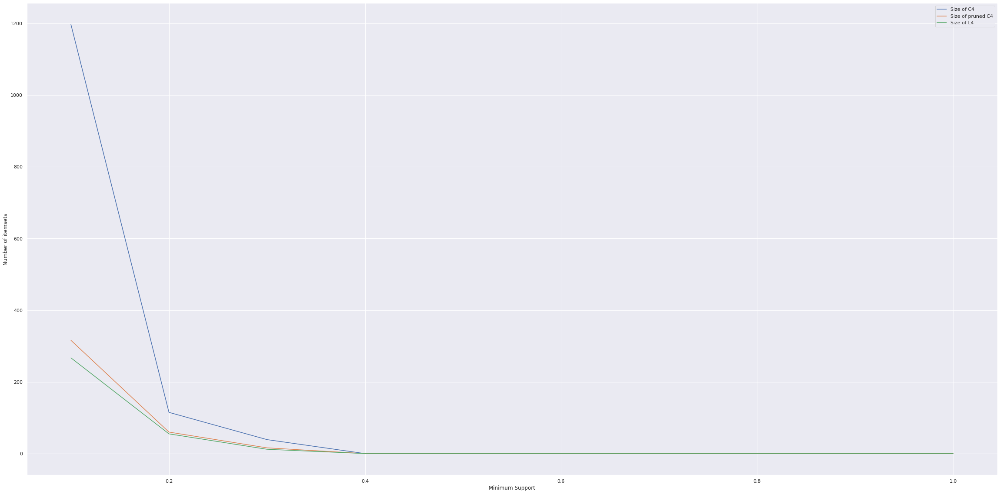

In [38]:
#plot
x = [i for i,_,_,_ in datapoints]
a = [a for _,a,b,c in datapoints]
b = [b for _,a,b,c in datapoints]
c = [c for _,a,b,c in datapoints]

plt.plot(x, a, label='Size of C4')
plt.plot(x, b, label='Size of pruned C4')
plt.plot(x, c, label='Size of L4')

plt.xlabel("Minimum Support")
plt.ylabel("Number of itemsets")
plt.legend()
display()

*Your markdown for your discussion.*

<font color='orange'>
The graph above depicts the size of the sets C4, pruned C4 and L4 with respect to some minimum support [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1]. The set C4 is given by all possible itemsets of size 4, while the pruned set C does not include certain sub and super itemsets that do not increase support. At last but not least, L4 is the set given by the apriori algorithm which contains itemsets of siz 4 with minimal support.
    First, we can see that if one increases the minimal support of the itemsets, fewer itemsets will satisfy this condition, and hence the size of the three itemsets gradually decreases. In this case, there are no itemsets with minimal support of at least 0,4.
    Second, we can see how pruning and or using the apriori algorithm dramatically decreases the number of itemsets we consider. This is the most apparent for lower minimal supports since this increases the size of the whole set. For minimal support 0.1, there are 1200 itemsets in C4. The size of C4 pruned and L4 are approx. 4 times lower.
<font>

d) Use the FP-Growth algorithm to obtain all frequent itemsets with **min_support = 0.3** from `customer_data_onehot`.

In [39]:
itemsets = fpgrowth(customer_data_onehot, min_support=0.3, use_colnames=True)

## Association Rules

**d)** In the following, you should generate association rules from the frequent itemsets.

1) Using only the frequent itemsets with min_support=0.3, generate different association rules using minimum confidence equal to 0.6 as a metric. Show the association rules.

In [40]:
rules = arule(itemsets, metric="confidence", min_threshold=0.6)
display(rules)

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
0,(Store),(Children),0.698094,0.715145,0.475426,0.681034,0.952302,-0.023813,0.893058
1,(Children),(Store),0.715145,0.698094,0.475426,0.664797,0.952302,-0.023813,0.900664
2,(No Sweets),(Store),0.543129,0.698094,0.379639,0.698984,1.001275,0.000483,1.002957
3,(Children),(No Sweets),0.715145,0.543129,0.481946,0.673913,1.240796,0.093529,1.401070
4,(No Sweets),(Children),0.543129,0.715145,0.481946,0.887350,1.240796,0.093529,2.528668
...,...,...,...,...,...,...,...,...,...
371,"(High, Meat)","(Sweets, Wine)",0.361585,0.392177,0.310431,0.858530,2.189141,0.168626,4.296478
372,"(High, Wine)","(Sweets, Meat)",0.372116,0.398696,0.310431,0.834232,2.092400,0.162070,3.627378
373,"(Wine, Meat)","(Sweets, High)",0.486961,0.317452,0.310431,0.637487,2.008135,0.155844,1.882823
374,(Sweets),"(High, Wine, Meat)",0.456871,0.356068,0.310431,0.679473,1.908267,0.147754,2.008979


2) From the association rules obtained in task (d) 1), provide the three rules with the highest lift. Comment on them.

In [41]:
rules.sort_values("lift", ascending=False).head(3)[["antecedents", "consequents", "lift"]]

,antecedents,consequents,lift
371,"(High, Meat)","(Sweets, Wine)",2.189141
370,"(Sweets, Wine)","(High, Meat)",2.189141
344,"(High, Meat)","(Wine, Fruits)",2.173974


The resulting three rules with the highest lift are:
   $$\{\text{Meat}, \text{High}\} \Rightarrow \{\text{Wine}, \text{Sweets}\},$$
   $$\{\text{Wine}, \text{Sweets}\} \Rightarrow \{\text{Meat}, \text{High}\},$$
   $$\{\text{Meat}, \text{High}\} \Rightarrow \{\text{Wine}, \text{Fruits}\}.$$
 With the first and third best rule, we see that if someone of high-income class buys meat, he will most likely also buy wine and some treats, in this case, either sweets or fruits. The second rule shows that the opposite is also true, i.e if someone buys wine and sweets that customer is most likely of the high-income class and will also buy meat.

 

# Q4 - Text Mining (15 points)
In this question, you will use the scripts of some Harry Potter movies. First, you will try to predict the character given a line in the script. Afterwards, using N-grams, you will generate sentences for some of the characters.

**a)** In this part, you will preprocess and reconstruct the data to make it suitable for the following tasks.

1) Load each of the datasets <b>hp_1.csv</b>, <b>hp_2.csv</b>, and <b>hp_3.csv</b> into its own dataframe and show the set of characters (here: a fictional character) appearing in each dataset.

In [42]:
# Import
df_1 = pd.read_csv("./dataset/hp_1.csv")
df_2 = pd.read_csv("./dataset/hp_2.csv")
df_3 = pd.read_csv("./dataset/hp_3.csv")

print('Characters in the first dataset (including duplicates w.r.t name variations):')
print(set(df_1['Character']))
print()
print('Characters in the second dataset  (including duplicates w.r.t name variations):')
print(set(df_2['Character']))
print()
print('Characters in the third dataset  (including duplicates w.r.t name variations):')
print(set(df_3['Character']))

Characters in the first dataset (including duplicates w.r.t name variations):
{'Lee  Jordan', 'Fred  ', 'Sir Nicholas', 'Whispers', 'Flitwick', 'Man in paint', 'Hermione  ', 'Flint  ', 'Students', 'Ron  ', 'Harry', 'Hagrid', 'Filch  ', 'Mrs. Weasley', 'Dudley', 'Man  ', 'McGonagall ', 'Girl  ', 'Griphook', 'Snake', 'Voldemort ', 'Ollivander', 'Draco  ', 'Harry ', 'Seamus  ', 'Dean', 'Girl', 'Quirrell', 'Dumbledore  ', 'Hermoine', 'Man', 'Boy  ', 'Ron   ', 'Seamus', 'Ron', 'Dumbledore ', 'Snape  ', 'Witch', 'Voldemort', 'Madam Hooch', 'Barkeep\xa0Tom', 'Filch ', 'Vernon', 'Filch', 'Someone', 'Flint', 'Boy', 'Harry  ', 'Quirrell ', 'Ginny', 'Hagrid  ', 'Goblin', 'Woman', 'Neville', 'Madam Hooch ', 'Malfoy', 'Firenze ', 'Hermione', 'Hermione ', 'All  ', 'Ron and Harry', 'Snape', 'Fred', 'Gryffindors  ', 'Dumbledore', 'Class', 'Crowd  ', 'Sorting Hat', 'Voldemort  ', 'George', 'Fat Lady', 'Firenze  ', 'Hagrid ', 'George  ', 'Percy  ', 'OIiver  ', 'McGonagall  ', 'Oliver  ', 'Ron and Harry 

2) Merge the three datasets into a single dataframe called `hp_df` that comprises only the lines spoken from one of the four characters *Harry, Hermione, Dumbledore, and Snape*. Your new dataframe must contain two columns: one for the (four) characters and the other for the lines. You can name those columns "Character" and "Sentence" as in the original data. \
    Make sure that `hp_df` contains a single unique spelling for each of the characters. \
    Make sure that `hp_df` includes all lines (here: script lines) of a character even if this character is spelled slightly differently (e.g., Dumbledore or dumbledore) in the original dataset. \
    Show the first few lines of your dataframe.
    
*Hint: Be aware of white space characters!*

In [43]:
# Get all variation for their names in the datasets
harry      = {'Harry ',  'HARRY', 'Harry','HARRY ','Harry  '}
dumbledore = {'Dumbledore ','DUMBLEDORE', 'Dumbledore', 'Dumbledore','Dumbledore  '}
hermione   = {'Hermione','Hermione ','HERMIONE', 'Hermione  ', 'Hermoine'}
snape      = {'Snape', 'Snape  ', 'Snake', 'Snake','Snape ','SNAPE'}
characters = set.union(harry, snape, dumbledore, hermione)

# Remove all other characters
filtered_df_1 = df_1[df_1['Character'].isin(characters)]
filtered_df_2 = df_2[df_2['Character'].isin(characters)]
filtered_df_3 = df_3[df_3['Character'].isin(characters)]

# Concatenate the 3 datasets
hp_df =  pd.concat([filtered_df_1, filtered_df_2,filtered_df_3], axis=0)

# Ensuring consistent naming convention for each character
char_list = ['Harry' if(w in harry) else 'Snape' if(w in snape) else 'Dumbledore' if(w in dumbledore) else 'Hermione' for w in hp_df['Character'].tolist()]
hp_df['Character'] = char_list
display(hp_df)

,Character,Sentence
0,Dumbledore,"I should've known that you would be here, Prof..."
3,Dumbledore,"I'm afraid so, professor."
4,Dumbledore,The good and the bad.
6,Dumbledore,Hagrid is bringing him.
8,Dumbledore,"Ah, Professor, I would trust Hagrid with my life."
...,...,...
1633,Hermione,"How fast is it, Harry?"
1634,Harry,Lumos.
1635,Harry,I solemnly swear that I am up to no good.
1636,Harry,Mischief managed.


3) Create the `hp_sampled` dataset which includes 90% of the `hp_df` data. Use the matriculation number of one of the group members as seed. Export the sampled dataset. 

In [44]:
# Sample 90% of the preprocessed dataset 
hp_sampled = hp_df.sample(n=int((0.9*len(hp_df))), random_state= 377031)

# Save as csv
hp_sampled.to_csv("./dataset/hp.csv")

**b)** In this part, you are going to train a classifier that, given a line from the script, predicts the character. For each character, the data contains many sentences belonging to that character. Note that sometimes the "Sentence" column in the original dataset contains more than one sentence. The set of sentences for each character should be seen as the set of example documents belonging to that character (the class). Each individual sentence is a single document. The whole corpus consists of all the individual sentences.

1) Create a new dataframe called `hp_processed` from the dataframe `hp_sampled` such that the new dataframe contains again the columns "Character" and "Sentence", but every entry in the "Sentence" column must be a single sentence. Display the shape of the dataframe and compare it to the shape of `hp_sampled`.

In [45]:
# This step is needed if you havent used nltk on the machine before
hp_processed=hp_sampled
sentences = hp_processed["Sentence"].tolist()
print('Size of dataset before preprocessing:', len(hp_processed))

# Iterate through dataset, identify multiple sentence texts and split them up
to_drop=[]
for i in range(len(sentences)) :
    # Sentence tokenization to separate sentences
    sen = sent_tokenize(sentences[i])
    if(len(sen)>1):
        to_drop.append(int(i))
        for w in sen:
            hp_processed=hp_processed.append({'Character': hp_processed.iloc[i,0],'Sentence': w}, ignore_index = True)
hp_processed.drop(to_drop, inplace=True)

# For comparison of size differences
print(len(to_drop), 'Multi-sentences have been identified, the size of dataset after preprocessing is:', len(hp_processed))

Size of dataset before preprocessing: 1689
228 Multi-sentences have been identified, the size of dataset after preprocessing is: 1938


2) Split the preprocessed data `hp_processed` into training (80%) and test (20%) data preserving the distribution based on "Character". 

In [46]:
# Split into training and testing data
hp_train, hp_test = train_test_split(hp_processed, train_size=0.8, random_state=377031)

3) Preprocess the training and test corpus (to lowercase, no punctuation, tokenization, lemmatization, and stopword removal) and obtain a boolean document-term matrix (i.e, each row in the matrix contains only 1s and 0s depending on whether a particular word appears in a sentence or not). Train a logistic classifier on the training corpus with the character as target feature. Use the classifier to predict the character of the sentences in the test corpus and show its accuracy on the test corpus. Comment on the result.

In [47]:
from nltk.tokenize import RegexpTokenizer
from sklearn.linear_model import LogisticRegression
import itertools

# Function that preprocesses given dataset(to lowercase, no punctuation, tokenization, lemmatization, and stopword removal)
def corpus_pre(hp):
    sentences = hp["Sentence"].tolist()
    n=len(sentences)
    # Init preprocessing
    tokenizer = nltk.RegexpTokenizer(r"\w+")
    stop_list = stopwords.words("english")
    lemmatizer = WordNetLemmatizer()
    # Iterate through sentences in dataset and apply the aforementioned preprocessing techniques
    for i in range(n):
        tokenized = tokenizer.tokenize(sentences[i])
        filtered = [word.lower() for word in tokenized if word.lower() not in stop_list]
        lemmatized = [lemmatizer.lemmatize(word) for word in filtered]
        sentences[i] = lemmatized
    return sentences

# Applying preprocessing function to test and trainig datasets
s_train = corpus_pre(hp_train)
n_train = hp_train.columns[1]
hp_train.drop(n_train, axis = 1, inplace = True)
hp_train['Sentence'] = s_train

s_test = corpus_pre(hp_test)
n_test = hp_test.columns[1]
hp_test.drop(n_test, axis = 1, inplace = True)
hp_test['Sentence'] = s_test

# Drop remaining empty sentences in training data
to_drop_train=[]
for idx, row in hp_train.iterrows():
    sen = hp_train.at[idx, 'Sentence']
    if(sen==[]):
        to_drop_train.append(idx)
hp_train.drop(to_drop_train, inplace=True)      

# Drop remaining empty sentences in testing data
to_drop_test=[]
for idx, row in hp_test.iterrows():
    sen = hp_test.at[idx, 'Sentence']
    if(sen==[]):
        to_drop_test.append(idx)
hp_test.drop(to_drop_test, inplace=True)   

# Function that computes the boolean document-term matrix for a given corpus and word list
def doc_matrix(df, words):
    charcaters = df['Character'].tolist()
    sentences = df['Sentence'].tolist()
    #create new column for each word with default value 0
    for i in range(len(words)):
        df[str(words[i])] = int(0)
    # For each example set the words appearing in its sentence to 1 
    for idx, row in df.iterrows():
        sentence = df.at[idx, 'Sentence']
        l = len(sentence)
        for i in range(l):
            df.at[idx, sentence[i]] = 1
    return df

# Store preprocessed dataset for next assignment
vec_train = hp_train.copy()
vec_test = hp_test.copy()

# Get all words appearing in the test or train corpus 
text_test = hp_test['Sentence'].tolist()
text_train = hp_train['Sentence'].tolist()
words = list(set.union(set(list(itertools.chain.from_iterable(text_test))) , set(list(itertools.chain.from_iterable(text_train))))) 

# Crate boolean document-term matrix for both datasets
hp_train = doc_matrix(hp_train, words)
hp_test = doc_matrix(hp_test, words)

# Drop the 'Sentence' column
hp_train.drop(columns=['Sentence'], inplace=True)
hp_test.drop(columns=['Sentence'], inplace=True)

# Display the preprocessed datasets
print('Training dataset:')
display(hp_train)
print('Testing dataset:')
display(hp_test)

# Logistic regression
# Separate the target feature from trainable features 
X_training= hp_train.loc[:, hp_train.columns != 'Character']
y_training= hp_train['Character']
X_testing= hp_test.loc[:, hp_test.columns != 'Character']
y_testing= hp_test['Character']

# Fit logistic regression model to training data
hp_classifier = LogisticRegression()
hp_classifier = hp_classifier.fit(X=X_training, y=y_training)

# Accuracy of the model
print('Evaluating model on training set')
print(hp_classifier.score(X_training, y_training))
print('Evaluating model on test set')
print(hp_classifier.score(X_testing, y_testing))

/tmp/ipykernel_83304/859157226.py:54: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  df[str(words[i])] = int(0)


Training dataset:


,Character,cup,hungry,flee,drunk,george,fur,met,shoe,flicker,perform,award,master,rosmerta,nick,norris,except,fortunately,honestly,...,hoped,talk,building,wish,tomorrow,harp,hope,never,least,bulstrode,chamber,rich,malfoy,wandering,shall,business,ravenclaw,remaining,elephant
234,Hermione,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1859,Hermione,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1046,Harry,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1755,Harry,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1795,Harry,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1679,Harry,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
153,Harry,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1229,Harry,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1035,Hermione,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


Testing dataset:


,Character,cup,hungry,flee,drunk,george,fur,met,shoe,flicker,perform,award,master,rosmerta,nick,norris,except,fortunately,honestly,...,hoped,talk,building,wish,tomorrow,harp,hope,never,least,bulstrode,chamber,rich,malfoy,wandering,shall,business,ravenclaw,remaining,elephant
1498,Harry,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2098,Hermione,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1610,Harry,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
172,Harry,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
545,Hermione,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1693,Snape,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
532,Dumbledore,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
769,Harry,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
863,Dumbledore,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


Evaluating model on training set
0.8215767634854771
Evaluating model on test set
0.5774647887323944


*Your markdown for your discussion.*

<font color='orange'>
For a given sentence from the Harry Potter books, the model tries to predict from which character it was from. He has a choice of 4 different characters, that is Harry, Hermione, Dumbledore, and Snape. The baseline for the model is a random guess, which on average should return an accuracy of 25%. 
    Our logistic regression model, trained on a one-hot encoding of all appearing words in the test and training set, predicts the character for a given sentence with an accuracy of about 58%. The accuracy of the training is very high at 80%, but this is to be expected. Therefore, our model is 2,3 times more accurate than the baseline. The model was trained on 1446 sentences, we think that we can achieve a higher accuracy if trained on more sentences, even though our current results are applicable.
<font>

4) Next, you are going to perform the same predicting task based on doc2vec.

1. Preprocess the training corpus (to lowercase, no punctuation, tokenization, lemmatization, and stopword removal). 
2. Create a doc2vec model to reduce the dimension of the document vector. Choose a vector size 4-8 and ignore all words whose count is lower than 3.
3. Train the doc2vec model on the training data (thus creating an embedding).
4. Use the created embedding to convert the training set to a set of document vectors.
5. Train a logistic classifier on the train data with the character as target feature.
6. Show the accuracy of prediction on the test data and comment on it.

In [48]:
#1) We use our allready preprocessed data(to lowercase, no punctuation, tokenization, lemmatization, and stopword removal)
corpus_train = vec_train['Sentence'].tolist()
corpus_test = vec_test['Sentence'].tolist()    

#2)
# Create TaggedDocument
tagged_docs_train = [TaggedDocument(doc, [i]) for i, doc in enumerate(corpus_train)]

# Determining parameters of the model (size 4-8) 
model = Doc2Vec(vector_size=4)

# Building the vocabulary    
model.build_vocab(tagged_docs_train)
training_examples = model.corpus_count

#3) Document embedding, train the model on the training examples
model.train(corpus_iterable=tagged_docs_train, total_examples=training_examples, epochs=100)

#4) Convert the training set to a set of document vectors
train_vectors = [model.infer_vector(doc) for doc in corpus_train]
train_target = vec_train['Character']
test_vectors = [model.infer_vector(doc) for doc in corpus_test]
test_target = vec_test['Character']

#5) Logistc regression
print('Creating classifier')
classifier_doc2vec = LogisticRegression()
classifier_doc2vec = classifier_doc2vec.fit(X=train_vectors, y=train_target)

#6) Evaluation
print('Evaluating model on test set')
print(classifier_doc2vec.score(test_vectors, test_target))

Creating classifier
Evaluating model on test set
0.532394366197183


*Your markdown for your discussion.*

<font color='orange'>
For this logistic regression model, we first trained a doc2vec model on the training data to create an embedding for us. This embedding lowers the dimension while trying to maintain the overall structure and context of the sentences. By lowering the dimension of the problem, we can observe a loss of 4% in the accuracy, compared to the logistic regression model trained on one-hot encoding for all possibly appearing words. Still, it is twice as good as the random guess baseline.
<font>

**c)** For the following tasks use the `hp_processed` (the data before splitting into training and test data).

1) For each character, create a list containing all sentences of that character.
    For each character separately, build a bigram language model using MLE. Do not perform stemming and stopword removal for this task, but apply other preprocessing steps such as to lowercase, no punctuation, and tokenization. Use both right and left padding.

In [49]:
# Create a list containing all sentences for the given character
harry = hp_processed[hp_processed['Character'] == 'Harry']['Sentence'].tolist()
dumbledore = hp_processed[hp_processed['Character'] == 'Dumbledore']['Sentence'].tolist()
hermione = hp_processed[hp_processed['Character'] == 'Hermione']['Sentence'].tolist()
snape = hp_processed[hp_processed['Character'] == 'Snape']['Sentence'].tolist()

# Function that applies lowercase, no punctuation, tokenization and right and left padding to corpus
def k_gram_model_with_pre(sentences, k=2):
    corpus_lemma = []
    n=len(sentences)
    # Init preprocessing
    tokenizer = nltk.RegexpTokenizer(r"\w+")
    lemmatizer = WordNetLemmatizer()
    # Iterate through sentences in dataset and apply the aforementioned preprocessing techniques
    for i in range(n):
        tokenized = tokenizer.tokenize(sentences[i])
        lemmatized = [lemmatizer.lemmatize(word) for word in tokenized]
        if lemmatized != []:
            corpus_lemma.append(lemmatized)
    # Apply left and right padding to the sentences
    padded_tuples, vocab = padded_everygram_pipeline(k, corpus_lemma)
    # Generate and fit kgram language model
    lm_gram = MLE(k)
    lm_gram.fit(padded_tuples, vocab)
    return lm_gram, padded_tuples, vocab, corpus_lemma

#For each character separately, build a bigram language model using MLE
lm_bigram_harry, padded_tuples_harry, vocab_harry, corpus_lemma_harry = k_gram_model_with_pre(harry, k=2)
lm_bigram_dumbledore, padded_tuples_dumbledore, vocab_dumbledore, corpus_lemma_dumbledore = k_gram_model_with_pre(dumbledore, k=2)
lm_bigram_hermione, padded_tuples_hermione, vocab_hermione, corpus_lemma_hermione = k_gram_model_with_pre(hermione, k=2)
lm_bigram_snape, padded_tuples_snape, vocab_snape, corpus_lemma_snape = k_gram_model_with_pre(snape, k=2)

2) For each character, use the created language model to generate a sentence of ten words. Display the sentences.

In [50]:
print('Ten word Bigram Sentence from Harry:')
print(lm_bigram_harry.generate(10))
print('Ten word Bigram Sentence from Dumbledore:')
print(lm_bigram_dumbledore.generate(10))
print('Ten word Bigram Sentence from Hermione:')
print(lm_bigram_hermione.generate(10))
print('Ten word Bigram Sentence from Snape:')
print(lm_bigram_snape.generate(10))

Ten word Bigram Sentence from Harry:
['s', 'a', 'wizard', 'can', 'I', 'll', 'knock', 'you', '</s>', '<s>']
Ten word Bigram Sentence from Dumbledore:
['leaf', 'a', 'he', 'wa', 'headmaster', '</s>', 'there', '</s>', '</s>', 'I']
Ten word Bigram Sentence from Hermione:
['never', 'die', '</s>', 'd', 'kill', 'his', 'best', 'friend', '</s>', '<s>']
Ten word Bigram Sentence from Snape:
['the', 'wrong', 'time', 'to', 'something', '</s>', 'wand', 'cause', 'devastation', 'with']


3) Build a 4-gram model with the same data as in the previous task. Use both right and left padding.

In [51]:
#For each character separately, build a 4-gram language model using MLE
lm_fgram_harry, padded_tuples_harry, vocab_harry, corpus_lemma_harry = k_gram_model_with_pre(harry, k=4)
lm_fgram_dumbledore, padded_tuples_dumbledore, vocab_dumbledore, corpus_lemma_dumbledore = k_gram_model_with_pre(dumbledore, k=4)
lm_fgram_hermione, padded_tuples_hermione, vocab_hermione, corpus_lemma_hermione = k_gram_model_with_pre(hermione, k=4)
lm_fgram_snape, padded_tuples_snape, vocab_snape, corpus_lemma_snape = k_gram_model_with_pre(snape, k=4)

4) For each character, use the created 4-gram language model to generate a sentence of ten words. Display the sentences.

In [52]:
print('Ten word 4-gram Sentence from Harry')
print(lm_fgram_harry.generate(10))
print('Ten word 4-gram Sentence from Dumbledore')
print(lm_fgram_dumbledore.generate(10))
print('Ten word 4-gram Sentence from Hermione')
print(lm_fgram_hermione.generate(10))
print('Ten word 4-gram Sentence from Snape')
print(lm_fgram_snape.generate(10))

Ten word 4-gram Sentence from Harry
['</s>', '</s>', '</s>', '</s>', '</s>', '</s>', '</s>', '</s>', '</s>', '</s>']
Ten word 4-gram Sentence from Dumbledore
['<s>', '<s>', '<s>', 'The', 'Chamber', 'of', 'Secrets', 'ha', 'indeed', 'been']
Ten word 4-gram Sentence from Hermione
['</s>', '</s>', '</s>', '</s>', '</s>', '</s>', '</s>', '</s>', '</s>', '</s>']
Ten word 4-gram Sentence from Snape
['Here', 's', 'the', 'proof', '</s>', '</s>', '</s>', '</s>', '</s>', '</s>']


In [53]:
# Own generating function used to compare the coherence from the sentences of both n-gram models
# This is just to get sentences which contain no paddings, since the short-mostly padded sentences are quite boring.

# Sentence generating function
def generate(lm_gram, n=10):
    gen = lm_gram.generate(n)
    while (True):
        if(not('</s>' in gen) and not('<s>' in gen)):
            print(gen)
            break
        gen = lm_gram.generate(n)
                
print('Ten word 4gram Sentence from Harry')
generate(lm_fgram_harry, n=10)
print('Ten word 4gram Sentence from Dumbledore')
generate(lm_fgram_dumbledore, n=10)
print('Ten word 4gram Sentence from Hermione')
generate(lm_fgram_hermione, n=10)
print('Ten word 4gram Sentence from Snape')
generate(lm_fgram_snape, n=10)

Ten word 4gram Sentence from Harry
['the', 'monster', 'then', 'what', 'did', 'kill', 'that', 'girl', '50', 'year']
Ten word 4gram Sentence from Dumbledore
['is', 'only', 'fitting', 'that', 'you', 'both', 'receive', 'Special', 'Awards', 'for']
Ten word 4gram Sentence from Hermione
['you', 'should', 'learn', 'to', 'take', 'better', 'care', 'of', 'your', 'pet']
Ten word 4gram Sentence from Snape
['I', 'told', 'Dumbledore', 'you', 'were', 'helping', 'a', 'friend', 'into', 'the']


5) Compare the sentences generated by the bigram model with the sentences generated by the 4-gram model.

*Your markdown for your discussion.*

<font color='orange'>
Generally, the higher n is, the more coherent the sentences are the n-gram generates. However, a higher n requires more data to consistently generate insightful sentences. We have encountered the problem that most of the time the 4-gram model generates sentences that contain many paddings, sometimes even just a 10 padding list. Padding indicates the beginning and end of a sentence, so the 4-gram most of the time generates only small sentences. This may be due to the small size of our training set, but it could also be that the characters in HP just naturally speak in short sentences. To compare the coherence between the bigram and 4-gram models, we wrote a generating function that keeps generating sentences till one appears with no padding. Then we can see that the 4-gram model sentences are more convincing to the character it tries to generate from. The quality of the longer, non-padded sentences is markedly worse then of the initial ones, which does not come as much of a suprise. They aer still superior to the Bigramm sentences, however.
<font>

# Q5 - Process Mining (23 points)

In this task, we consider a simulated process of students that participate in an online course.
The course comprises 6 batches of lecture material as well as a mandatory assignment to be delivered in two parts. (Note that in this process, it is not required to achieve a certain score in the assignment in order to be admitted to the exam.)

While there are strict deadlines for the assignment and the exam, there is only a recommended schedule for the lecture material (i.e., consume material in order).

The system logs for every student, among other activities, when he downloads a certain lecture material batch. 

## Loading the Data and Basic Statistics

**a)** Load the data **log.csv** and create a PM4Py event log. In doing so, use the following column mapping:
 - 'Activity' is the activity key
 - 'Student' is the case ID
 - 'Timestamp' is the timestamp

In [54]:
from pm4py.objects.conversion.log import converter as log_converter

#import the csv-file 
df = pd.read_csv('dataset/log.csv', sep=',')
display(df.head())
df = pm4py.format_dataframe(df, case_id='Student', activity_key='Activity', timestamp_key='Timestamp')
# Let's see what this does
display(df.head())
log = log_converter.apply(df)

,Timestamp,Student,Activity,Lifecycle,Points
0,2021-09-15 00:18:18,346630,Register,complete,NaN
1,2021-09-15 00:27:35,351651,Register,complete,NaN
2,2021-09-15 01:23:21,343682,Register,complete,NaN
3,2021-09-15 01:37:35,343951,Register,complete,NaN
4,2021-09-15 01:55:36,348017,Register,complete,NaN


,time:timestamp,case:concept:name,concept:name,Lifecycle,Points,@@index
1413,2021-10-05 21:29:31+00:00,343516,Register,complete,NaN,1413
6537,2021-12-03 08:30:11+00:00,343516,Assignment 1,complete,78.0,6537
7060,2021-12-03 21:39:25+00:00,343516,Consume Lecture Material 3,complete,NaN,7060
8198,2021-12-05 04:04:49+00:00,343516,Consume Lecture Material 1,complete,NaN,8198
8868,2021-12-06 05:21:45+00:00,343516,Consume Lecture Material 2,complete,NaN,8868


**b)** Compute the following basic information:
- Number of events
- Number of cases
- Earliest timestamp
- Latest timestamp
- Number of trace variants

In [55]:
events_number = len(df)
cases_number = df['case:concept:name'].nunique()

sort_timestamp = sorted(df['time:timestamp'])
earliest_timestamp = sort_timestamp[0]
latest_timestamp =  sort_timestamp[-1]

variants = case_statistics.get_variant_statistics(log)
variants_sorted = sorted(variants, key=lambda x: x['count'], reverse=True)
variants_count = len(variants)

**c)** Usually, it is insightful to have a look at the distribution of the variants in terms of how often a certain variant is present in the log.
Therefore, create a **scatter plot** that shows the distribution of the variants as follows:
- x-axis: The variants (in ascending order of their support)
- y-axis: Frequency of the variant in the log (total or relative)

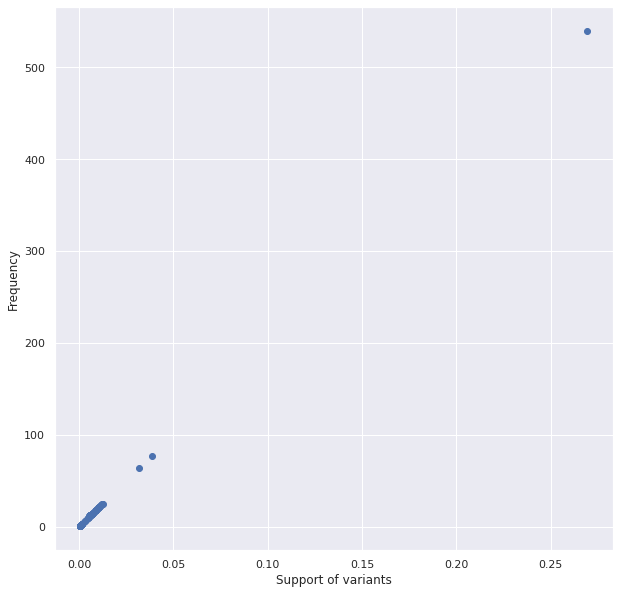

In [56]:
#x_axis
x_axis = []
variants_sorted_by_supp = sorted(variants, key= lambda x: x['count']/ len(log), reverse=False)
for i in range (len(variants_sorted_by_supp)):
    x_axis.append(variants_sorted_by_supp[i]['count']/len(log))

#y_axis
y_axis = []
for i in range (len(variants_sorted_by_supp)):
    y_axis.append(variants_sorted_by_supp[i]['count'])
#print (y_axis)

#plot
plt.figure(figsize=(10, 10))
plt.scatter(x_axis, y_axis )
plt.xlabel('Support of variants')
plt.ylabel('Frequency')
plt.show()

**d)** While the variant distribution shows potential standard process executions in terms of the activity ordering, the distribution of the case durations shows the typical timeframe of cases.
Create a histogram plot over the case durations. For the sake of readability, make sure that the x-axis labels (in this case the case durations) have an easily readable format, that is, your x-axis labels should look like this:
<br></br>
<div>
<img src="templates/caseDurationXAxis.png" width="500"/>
</div>

,time:timestamp
case:concept:name,
343516,"[2021-10-05 21:29:31+00:00, 2021-12-03 08:30:1..."
343526,"[2021-10-11 10:31:23+00:00, 2021-11-01 09:18:4..."
343536,"[2021-10-02 12:49:24+00:00, 2021-10-24 08:43:3..."
343543,"[2021-09-21 02:22:58+00:00, 2021-12-03 01:22:3..."
343546,"[2021-10-01 08:59:49+00:00, 2021-11-28 08:12:0..."


,time:timestamp,Case_duration
case:concept:name,,
343516,"[2021-10-05 21:29:31+00:00, 2021-12-03 08:30:1...",112 days 16:33:20
343526,"[2021-10-11 10:31:23+00:00, 2021-11-01 09:18:4...",132 days 03:28:37
343536,"[2021-10-02 12:49:24+00:00, 2021-10-24 08:43:3...",141 days 01:10:36
343543,"[2021-09-21 02:22:58+00:00, 2021-12-03 01:22:3...",152 days 11:37:02
343546,"[2021-10-01 08:59:49+00:00, 2021-11-28 08:12:0...",142 days 05:00:11


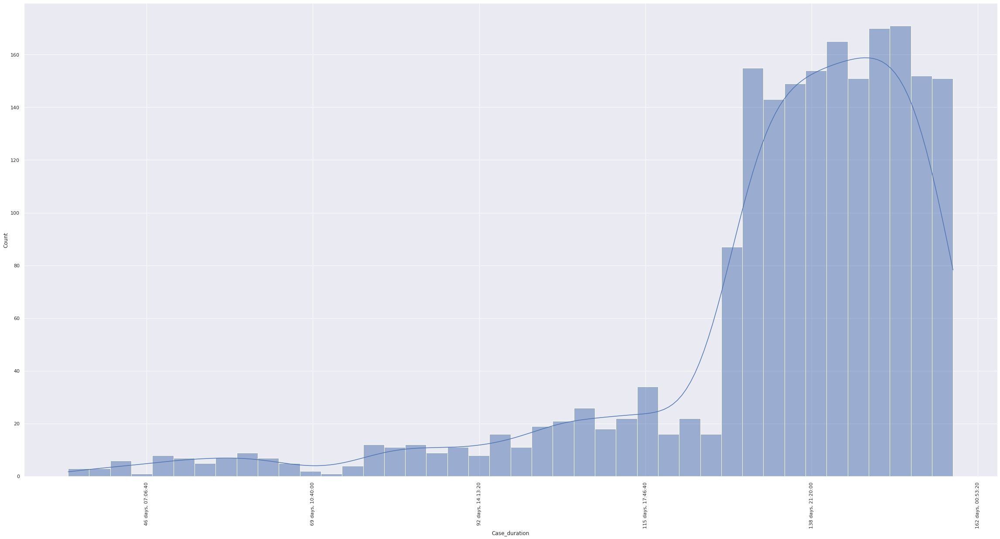

In [57]:
from matplotlib.dates import DateFormatter, date2num
from matplotlib.ticker import FuncFormatter

#Create a new dataframe where we associate to each student the sorted timestamps of his/her activities 
df_grouped = pd.DataFrame(df.groupby('case:concept:name')['time:timestamp'].apply(lambda s: s.unique()))
display(df_grouped.head())

#compute the durations
case_durations=[]
for i in range(cases_number):
    diff=df_grouped['time:timestamp'][i][-1] - df_grouped['time:timestamp'][i][0]
    case_durations.append(diff)
#add a new column
df_grouped.loc[:,'Case_duration'] =  case_durations
display(df_grouped.head())

#plt.figure(figsize=(10,10))
fig, ax = plt.subplots(figsize=(40, 20))
sns.histplot(data=df_grouped['Case_duration'].astype('timedelta64[s]'), kde=True ); 
ax.tick_params(axis='x', labelrotation=90)


from matplotlib.ticker import FuncFormatter

def format_func(n, pos):
    day = int(n // (86400))
    hour = int ((n % 86400) // 3600)
    minutes = int((n % 3600) // 60)
    seconds = int(n % 60)
    
    return "{:d} days, {:02d}:{:02d}:{:02d} ".format(int(day), hour, minutes, seconds)

formatter = FuncFormatter(format_func)
ax.xaxis.set_major_formatter(formatter)

plt.show()

## Discovery and Conformance Checking
Next, you are going to discover process models for different perspectives on the process. Moreover, you will evaluate how well the process models can represent the behavior present in the log (i.e., the fitness of the models).

### Filtering

**e)** Before discovering models, create three addtional perspectives onto the process by creating three additional event log from the log loaded in a):

1. Log containing only 30% of the most frequent traces (**log_varaint03**)
2. Log containing only 50% of the most frequent traces (**log_varaint05**)
3. Log containing only students that take the exam, that is, cases that end with 'Exam' (**log_exam**)

In [58]:
from pm4py.algo.filtering.log.end_activities import end_activities_filter

log_variant03 = variants_filter.filter_log_variants_percentage(log, percentage=0.3)
log_variant05 = variants_filter.filter_log_variants_percentage(log, percentage=0.5)
log_exam = end_activities_filter.apply(log, ["Exam"])

### Inductive Miner and Replay Fitness

**f)** To get a better understanding of the processes in our four event logs (base log + three additional logs), create processes models using the **Inductive Miner**.
Concretely, for each of the 4 event logs, create two process models using the Inductive Miner with noise threshold **0 and 0.2**. Moreover, to access how well the model presents the logged behavior, apply conformance checking in terms of token-based replay to the model and the log from which it has been mined. Visualize each model as a process tree and as the corresponding Petri net.

In total, your cells should output 8 conformance scores, 8 process trees, and 8 Petri nets (for each log + noise threshold combination). Make sure that it is clear which model and conformance score belongs to log and parameter configuration.

For example, your output can look like this
#### Log: Base
##### IM threshold 0
>Fitness score

>Picture of the process tree

>Picture of the Petri net

##### IM threshold 0.2
>Fitness score

>Picture of the process tree

>Picture of the Petri net

**Describe your results**. How well do the models fit and, in particular, how do the models for
- log_variant05 and log (base log)
- log_variant05 and log_variant03
- log base and log_exam

differ in terms of the behavior that they allow?


In [59]:
######################LOG########################

###IM threshold 0###

proc_tree_l_im1 = pm4py.discover_process_tree_inductive(log)
gviz_l_im1 = pt_visualizer.apply(proc_tree_l_im1, parameters={pt_visualizer.Variants.WO_DECORATION.value.Parameters.FORMAT: "png"})

#Let's convert the process tree into a Petri net
net_l_im1, im_l_im1, fm_l_im1 = pt_converter.apply(proc_tree_l_im1)

# Computing trace fitness
#token_replay_result = token_based_replay.apply(log, net, im, fm)
fitness_l_im1 = replay_fitness_evaluator.apply(log, net_l_im1, im_l_im1, fm_l_im1, variant=replay_fitness_evaluator.Variants.TOKEN_BASED)

###IM threshold 0.2###

proc_tree_l_im2 = pm4py.discover_process_tree_inductive(log, noise_threshold=0.2)
gviz_l_im2 = pt_visualizer.apply(proc_tree_l_im2, parameters={pt_visualizer.Variants.WO_DECORATION.value.Parameters.FORMAT: "png"})

#Let's convert the process tree into a Petri net
net_l_im2, im_l_im2, fm_l_im2 = pt_converter.apply(proc_tree_l_im2)

# Computing trace fitness
#token_replay_result = token_based_replay.apply(log, net, im, fm)
fitness_l_im2 = replay_fitness_evaluator.apply(log, net_l_im2, im_l_im2, fm_l_im2, variant=replay_fitness_evaluator.Variants.TOKEN_BASED)


######################LOG_VARIANT03#########################

###IM threshold 0###

proc_tree_lv3_im1 = pm4py.discover_process_tree_inductive(log_variant03)
gviz_lv3_im1 = pt_visualizer.apply(proc_tree_lv3_im1, parameters={pt_visualizer.Variants.WO_DECORATION.value.Parameters.FORMAT: "png"})

#Let's convert the process tree into a Petri net
net_lv3_im1, im_lv3_im1, fm_lv3_im1 = pt_converter.apply(proc_tree_lv3_im1)

# Computing trace fitness
#token_replay_result = token_based_replay.apply(log, net, im, fm)
fitness_lv3_im1 = replay_fitness_evaluator.apply(log_variant03, net_lv3_im1, im_lv3_im1, fm_lv3_im1, variant=replay_fitness_evaluator.Variants.TOKEN_BASED)

###IM threshold 0.2###

proc_tree_lv3_im2 = pm4py.discover_process_tree_inductive(log_variant03, noise_threshold=0.2)
gviz_lv3_im2 = pt_visualizer.apply(proc_tree_lv3_im2, parameters={pt_visualizer.Variants.WO_DECORATION.value.Parameters.FORMAT: "png"})

#Let's convert the process tree into a Petri net
net_lv3_im2, im_lv3_im2, fm_lv3_im2 = pt_converter.apply(proc_tree_lv3_im2)

# Computing trace fitness
#token_replay_result = token_based_replay.apply(log, net, im, fm)
fitness_lv3_im2 = replay_fitness_evaluator.apply(log_variant03, net_lv3_im2, im_lv3_im2, fm_lv3_im2, variant=replay_fitness_evaluator.Variants.TOKEN_BASED)


#########################LOG_VARIANT05##########################

###IM threshold 0###

proc_tree_lv5_im1 = pm4py.discover_process_tree_inductive(log_variant05)
gviz_lv5_im1 = pt_visualizer.apply(proc_tree_lv5_im1, parameters={pt_visualizer.Variants.WO_DECORATION.value.Parameters.FORMAT: "png"})

#Let's convert the process tree into a Petri net
net_lv5_im1, im_lv5_im1, fm_lv5_im1 = pt_converter.apply(proc_tree_lv5_im1)

# Computing trace fitness
#token_replay_result = token_based_replay.apply(log, net, im, fm)
fitness_lv5_im1 = replay_fitness_evaluator.apply(log_variant05, net_lv5_im1, im_lv5_im1, fm_lv5_im1, variant=replay_fitness_evaluator.Variants.TOKEN_BASED)

###IM threshold 0.2###

proc_tree_lv5_im2 = pm4py.discover_process_tree_inductive(log_variant05, noise_threshold=0.2)
gviz_lv5_im2 = pt_visualizer.apply(proc_tree_lv5_im2, parameters={pt_visualizer.Variants.WO_DECORATION.value.Parameters.FORMAT: "png"})

#Let's convert the process tree into a Petri net
net_lv5_im2, im_lv5_im2, fm_lv5_im2 = pt_converter.apply(proc_tree_lv5_im2)

# Computing trace fitness
#token_replay_result = token_based_replay.apply(log, net, im, fm)
fitness_lv5_im2 = replay_fitness_evaluator.apply(log_variant05, net_lv5_im2, im_lv5_im2, fm_lv5_im2, variant=replay_fitness_evaluator.Variants.TOKEN_BASED)


##########################LOG_EXAM##########################

###IM threshold 0###

proc_tree_le_im1 = pm4py.discover_process_tree_inductive(log_exam)
gviz_le_im1 = pt_visualizer.apply(proc_tree_le_im1, parameters={pt_visualizer.Variants.WO_DECORATION.value.Parameters.FORMAT: "png"})

#Let's convert the process tree into a Petri net
net_le_im1, im_le_im1, fm_le_im1 = pt_converter.apply(proc_tree_le_im1)

# Computing trace fitness
#token_replay_result = token_based_replay.apply(log, net, im, fm)
fitness_le_im1 = replay_fitness_evaluator.apply(log_exam, net_le_im1, im_le_im1, fm_le_im1, variant=replay_fitness_evaluator.Variants.TOKEN_BASED)

###IM threshold 0.2###

proc_tree_le_im2 = pm4py.discover_process_tree_inductive(log_exam, noise_threshold=0.2)
gviz_le_im2 = pt_visualizer.apply(proc_tree_le_im2, parameters={pt_visualizer.Variants.WO_DECORATION.value.Parameters.FORMAT: "png"})

#Let's convert the process tree into a Petri net
net_le_im2, im_le_im2, fm_le_im2 = pt_converter.apply(proc_tree_le_im2)

# Computing trace fitness
#token_replay_result = token_based_replay.apply(log, net, im, fm)
fitness_le_im2 = replay_fitness_evaluator.apply(log_exam, net_le_im2, im_le_im2, fm_le_im2, variant=replay_fitness_evaluator.Variants.TOKEN_BASED)



replaying log with TBR, completed variants :: 100%|██████████| 397/397 [00:00<00:00, 2091.85it/s]


LOG: BASE
IM threshold 0


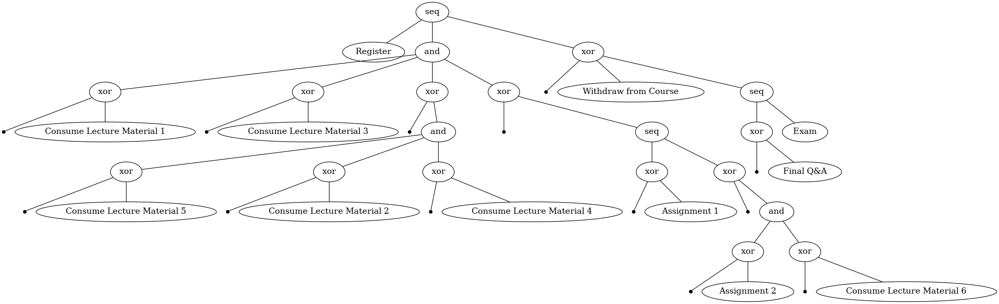

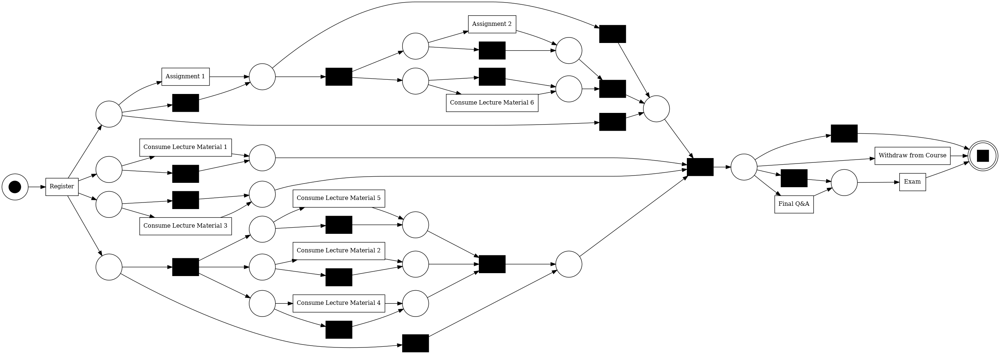

{'perc_fit_traces': 100.0,
 'average_trace_fitness': 1.0,
 'log_fitness': 1.0,
 'percentage_of_fitting_traces': 100.0}

IM threshold 0.2


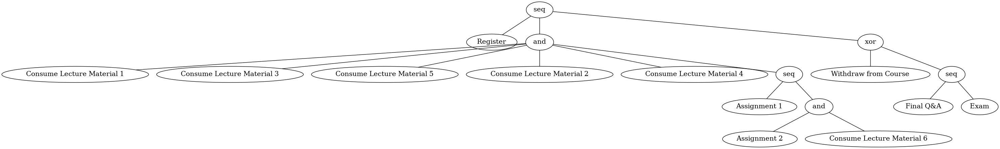

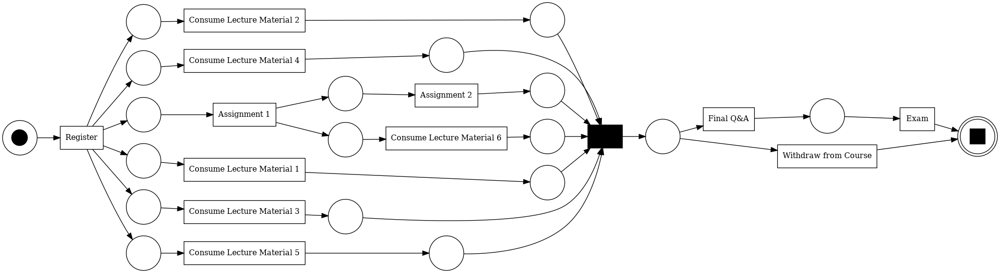

{'perc_fit_traces': 69.3,
 'average_trace_fitness': 0.905576373340711,
 'log_fitness': 0.9325048340840334,
 'percentage_of_fitting_traces': 69.3}

LOG: VARIANT03
IM threshold 0


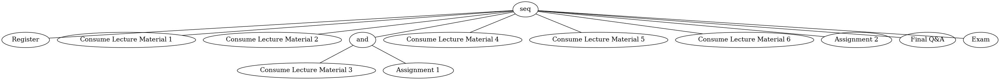

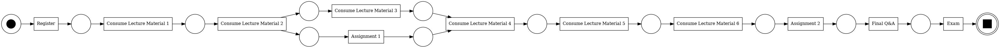

{'perc_fit_traces': 100.0,
 'average_trace_fitness': 1.0,
 'log_fitness': 1.0,
 'percentage_of_fitting_traces': 100.0}

IM threshold 0.2


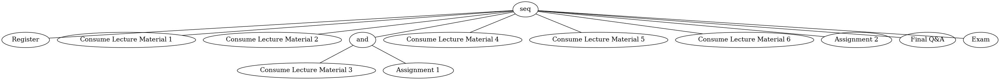

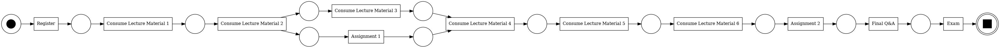

{'perc_fit_traces': 100.0,
 'average_trace_fitness': 1.0,
 'log_fitness': 1.0,
 'percentage_of_fitting_traces': 100.0}

LOG: VARIANT05
IM threshold 0


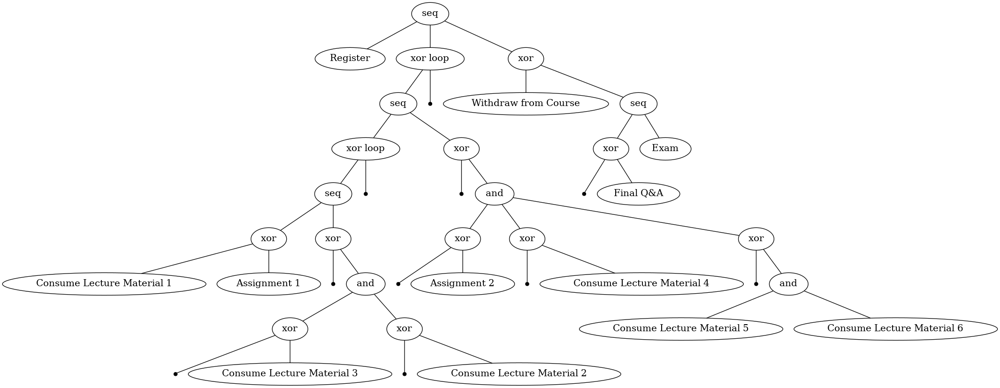

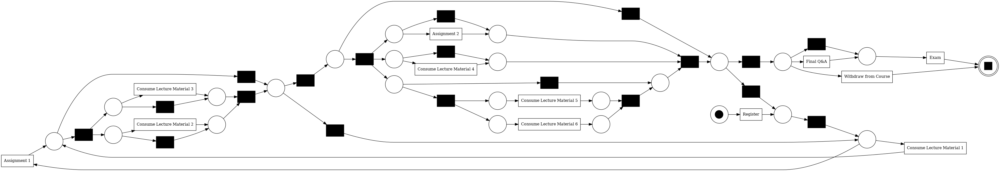

{'perc_fit_traces': 100.0,
 'average_trace_fitness': 1.0,
 'log_fitness': 1.0,
 'percentage_of_fitting_traces': 100.0}

IM threshold 0.2


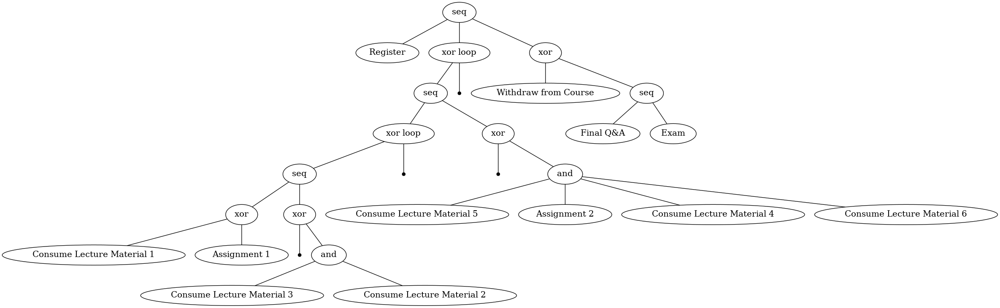

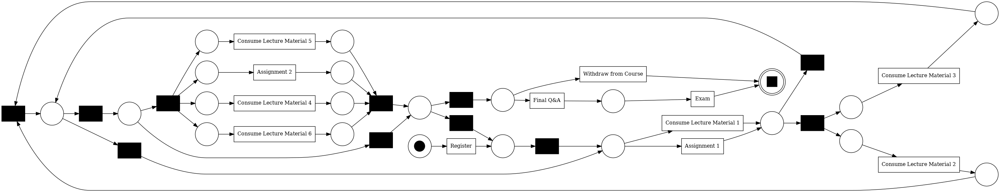

{'perc_fit_traces': 76.86196623634558,
 'average_trace_fitness': 0.9803935624172175,
 'log_fitness': 0.9844609736446894,
 'percentage_of_fitting_traces': 76.86196623634558}

LOG: EXAM
IM threshold 0


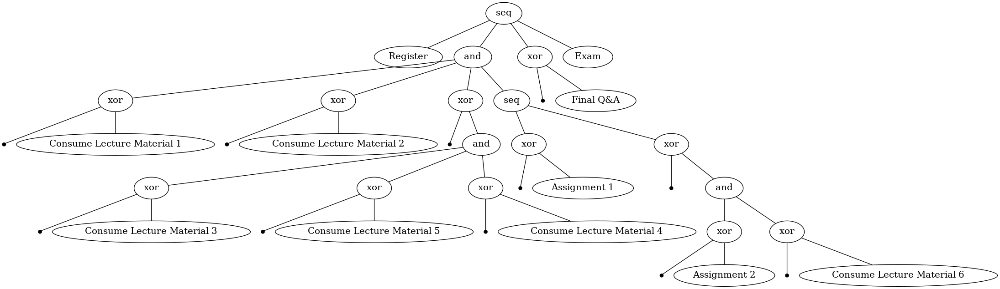

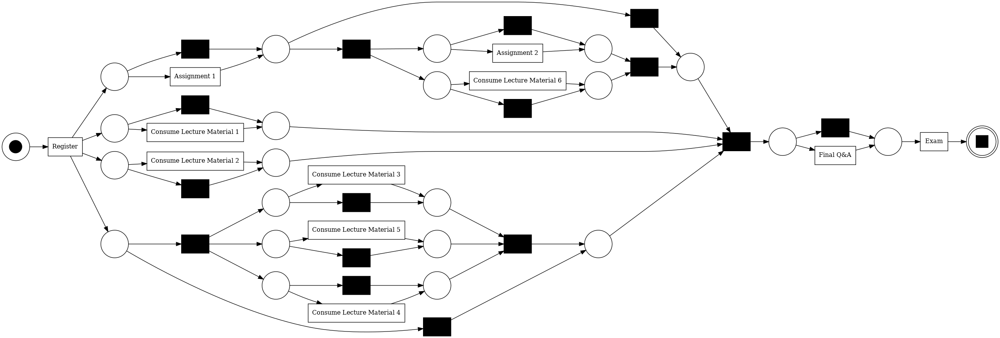

{'perc_fit_traces': 100.0,
 'average_trace_fitness': 1.0,
 'log_fitness': 1.0,
 'percentage_of_fitting_traces': 100.0}

IM threshold 0.2


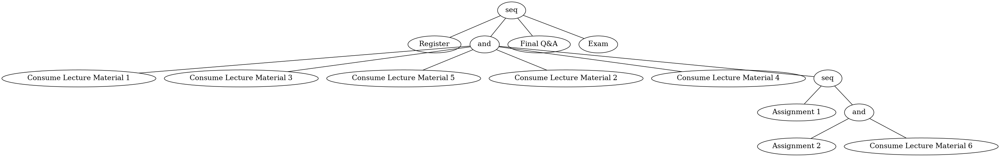

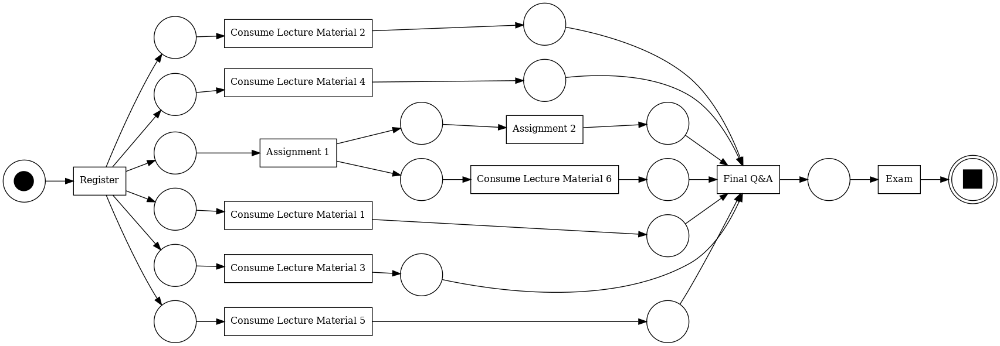

{'perc_fit_traces': 77.51677852348993,
 'average_trace_fitness': 0.9420329422692011,
 'log_fitness': 0.9557918485072727,
 'percentage_of_fitting_traces': 77.51677852348993}

In [60]:
#Let's visualize the results

#logIM0
print('LOG: BASE')
print('IM threshold 0')
pt_visualizer.view(gviz_l_im1)
pm4py.view_petri_net(net_l_im1, im_l_im1, fm_l_im1, format='png')  
display(fitness_l_im1)

#logIM0.2
print('IM threshold 0.2')
pt_visualizer.view(gviz_l_im2)
pm4py.view_petri_net(net_l_im2, im_l_im2, fm_l_im2, format='png')
display(fitness_l_im2)

#log_varaint03IM0
print('LOG: VARIANT03')
print('IM threshold 0')
pt_visualizer.view(gviz_lv3_im1)
pm4py.view_petri_net(net_lv3_im1, im_lv3_im1, fm_lv3_im1, format='png')  
display(fitness_lv3_im1)

#log_varaint03IM0.2
print('IM threshold 0.2')
pt_visualizer.view(gviz_lv3_im2)
pm4py.view_petri_net(net_lv3_im2, im_lv3_im2, fm_lv3_im2, format='png')
display(fitness_lv3_im2)

#log_variant05IM0
print('LOG: VARIANT05')
print('IM threshold 0')
pt_visualizer.view(gviz_lv5_im1)
pm4py.view_petri_net(net_lv5_im1, im_lv5_im1, fm_lv5_im1, format='png')  
display(fitness_lv5_im1)

#log_variant05IM0.2
print('IM threshold 0.2')
pt_visualizer.view(gviz_lv5_im2)
pm4py.view_petri_net(net_lv5_im2, im_lv5_im2, fm_lv5_im2, format='png')  
display(fitness_lv5_im2)

#log_examIM0
print('LOG: EXAM')
print('IM threshold 0')
pt_visualizer.view(gviz_le_im1)
pm4py.view_petri_net(net_le_im1, im_le_im1, fm_le_im1, format='png')  
display(fitness_le_im1)

#log_examIM0.2
print('IM threshold 0.2')
pt_visualizer.view(gviz_le_im2)
pm4py.view_petri_net(net_le_im2, im_le_im2, fm_le_im2, format='png')  
display(fitness_le_im2)

```The calculation of the replay fitness aim to calculate how much of the behavior in the log is admitted by the process model.
    Most of the process models we obtained fit very well. The only case in which the average_fitness is not maximum is when we allow a noise_threshold. In these cases the fitness records good results, very close to 1.
    A common operation is to focus on reduced number of variants as they might be sufficient to capture most of the process. In this case we considered two reduced log: log_variant03 and log_variant05. 
    If we compare log_variant05 with Log base we can see a different behaviour alowed from the models. In particular in base Log model IM0 we can notice from the process tree that there is no general order in material consuption. Only the partial order to execute 'Assignment 1' before 'Assignment 2' and 'Consume lecture material 6' is respected. In Log_variant05 IM0 we can observe from process tree a Xor loop after the registration of the course. In this loop an order in performig tasks is respected, in particolar the material of lecture 1 or the Assignment 1 are performed before consuming material of Lecture 3 and Lecture 2. In addition, material for Lecture 1, Lecture 2 and Lecture 3 is in general consumed before Lecture Materia 4, 5 and 6.By looking at the two models without noise, what we have deduced so far becomes clearer. In particular, in the process tree of log_variant05 IM0.2 the consuption attivities of lecture 5, 4 and 6 and the Assignment2 are now directly linked to a parallel composition, without passing through the xor anymore. Same thing for log base IM0.2 process tree where where most of the have been eliminated.
    In general, we can see how by filtering out the 50% most frequent traces we begin to discern a partial order in the consumption of lecture and assignment materials. 
    Let's now compare log_variant05 with log_variant03.  The latter shows a model that allows for more orderly task execution behavior than the log_variant05 based model.The process trees of log_variant03 with and without threshold are the same, meaning that there are no outlier. In log_variant03 Lecture materials as well as the Assignment are consumed in the order they should be. This makes sense since we are considering the variants that fall within the top 30% of the most frequent ones.
    Regarding Log base and Log_exam we can take a look at the respective process tree for IM0. In this case we have two differences in the allowed paths: the first one is that in the model based on log_exam the activity 'Exam' is mandatory because it's linked to a sequential composition and this happens because of the nature of log_exam; the second one is the presence of an extra Exclusive choice in the log base process tree with respect the log_exam one. This exclusive choice is placed before the activity of Assignement 1 and could mean that there are some students, who don't take the exam, and decide to drop the course before Assignment 1. However this choice is very rare since by applying a threshold on the same model the xor disappear.```

### Paths of Excellence

**g)** As lectures are in a constant urge to improve their courses in a way that participants learn as much as possible ;), you are facing the research question to identify *paths of excellence*.
In particular, you should identify how the studying behavior differs between excellent students (**final exam score greater than or equal to 85**) and non-excellent students (**final exam score less than 85**).
Try to answer this research questions using techniques from the preceding Process Mining questions. 

*Hint: There is no single unique solution (e.g., in terms of parameter choice); therefore, it suffices if your "design choices" are reasonble.* \
*Hint: The final exam score is point score that is associated with the "Exam" event.*


replaying log with TBR, completed variants :: 100%|██████████| 395/395 [00:00<00:00, 1835.53it/s]


LOG: LOG_EXCELLENT


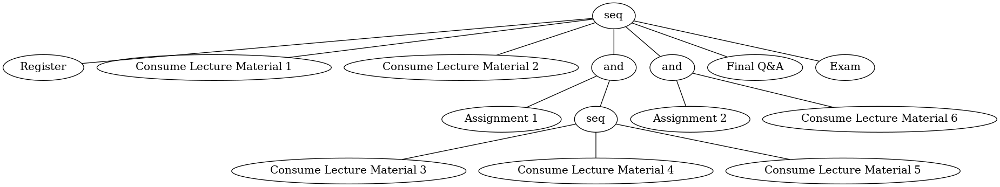

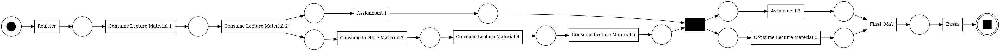

{'perc_fit_traces': 94.32314410480349,
 'average_trace_fitness': 0.9935884106189784,
 'log_fitness': 0.9945269741985927,
 'percentage_of_fitting_traces': 94.32314410480349}

LOG: LOG_NOT_EXCELLENT


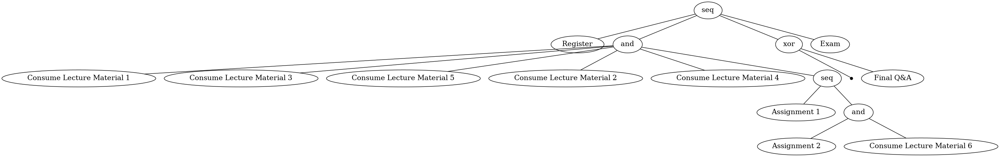

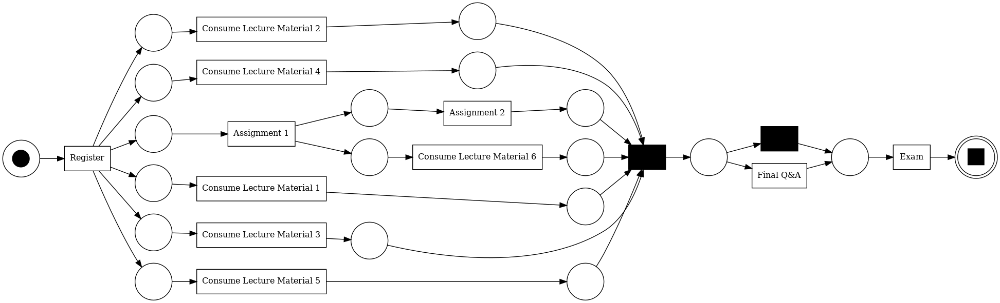

{'perc_fit_traces': 81.17958913187542,
 'average_trace_fitness': 0.9448050843318947,
 'log_fitness': 0.9617597006589034,
 'percentage_of_fitting_traces': 81.17958913187542}

In [61]:
log_excellent = pm4py.filter_log(lambda t: any(map(lambda e: e['Points']>=85 , t)), log_exam)
log_not_excellent = pm4py.filter_log(lambda t: any(map(lambda e: e['Points']<85, t)), log_exam)

#Excellent students

proc_tree_ex = pm4py.discover_process_tree_inductive(log_excellent, noise_threshold=0.2)
gviz_ex = pt_visualizer.apply(proc_tree_ex, parameters={pt_visualizer.Variants.WO_DECORATION.value.Parameters.FORMAT: "png"})

#Let's convert the process tree into a Petri net
net_ex, im_ex, fm_ex = pt_converter.apply(proc_tree_ex)

# Computing trace fitness
#token_replay_result = token_based_replay.apply(log, net, im, fm)
fitness_ex = replay_fitness_evaluator.apply(log_excellent, net_ex, im_ex, fm_ex, variant=replay_fitness_evaluator.Variants.TOKEN_BASED)


#Not Excellent students

proc_tree_not_ex = pm4py.discover_process_tree_inductive(log_not_excellent, noise_threshold=0.2)
gviz_not_ex = pt_visualizer.apply(proc_tree_not_ex, parameters={pt_visualizer.Variants.WO_DECORATION.value.Parameters.FORMAT: "png"})

#Let's convert the process tree into a Petri net
net_not_ex, im_not_ex, fm_not_ex = pt_converter.apply(proc_tree_not_ex)

# Computing trace fitness
#token_replay_result = token_based_replay.apply(log, net, im, fm)
fitness_not_ex = replay_fitness_evaluator.apply(log_not_excellent, net_not_ex, im_not_ex, fm_not_ex, variant=replay_fitness_evaluator.Variants.TOKEN_BASED)

print('LOG: LOG_EXCELLENT')
pt_visualizer.view(gviz_ex)
pm4py.view_petri_net(net_ex, im_ex, fm_ex, format='png')  
display(fitness_ex)

print('LOG: LOG_NOT_EXCELLENT')
pt_visualizer.view(gviz_not_ex)
pm4py.view_petri_net(net_not_ex, im_not_ex, fm_not_ex, format='png')  
display(fitness_not_ex)

```Both process models we obtained fit very well.
    In this case the difference is clear. The behaviour of execellent students is more sequential and follows the correct order of the activities. Material from all lessons is consumed. They are also consumed in the order they should be, from lesson 1 to lesson 6 one after the other, following the correct timings in order to be able to do assignments 1 and 2. 
    The behaviour of the non-excellent students is different. Lecture materials can be consumed in all possible ways, including the Assignment 1. The order in which the material is made available is not followed. Students can consume material in different order. According to the model obtained, non-excellent students are allowed to decide whether to participate in the final q&a or not in contrast to excellent students who always participate in the Q&A before taking the exam.```

## Performance and Frequency Decoration

**h)** While the discovery of a process model is the most prototypical step in a process mining analysis, its enrichment by frequency and performance statistics is a very common step too. To this end, enrich the Petri net that you discovered for log_exam using Inductive Miner with noise threshold 0.2 by frequency and performance information. Plot two Petri nets decorated with frequency and performance information, respectively.

Describe your results. Can you observe any problems (in particular with respect to the initial process description)?

replaying log with TBR, completed variants :: 100%|██████████| 397/397 [00:00<00:00, 2108.71it/s]


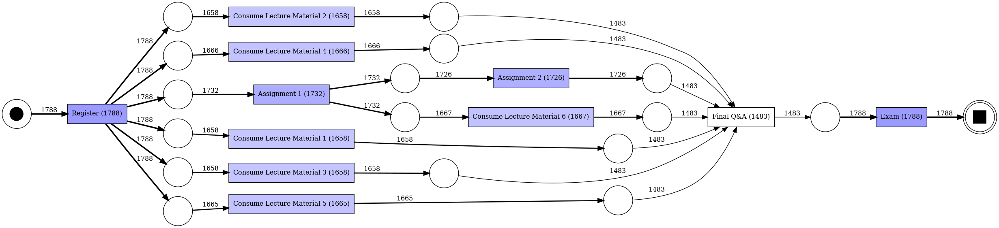

In [62]:
parameters = {pn_visualizer.Variants.FREQUENCY.value.Parameters.FORMAT: "png"}
gviz = pn_visualizer.apply(net_le_im2, im_le_im2, fm_le_im2, parameters=parameters, variant=pn_visualizer.Variants.FREQUENCY, log=log_exam)
pn_visualizer.view(gviz)

replaying log with TBR, completed variants :: 100%|██████████| 397/397 [00:00<00:00, 1968.95it/s]


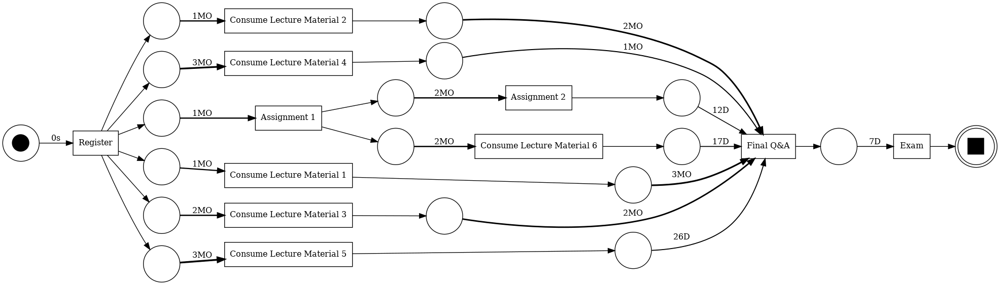

In [63]:
parameters = {pn_visualizer.Variants.FREQUENCY.value.Parameters.FORMAT: "png"}
gviz = pn_visualizer.apply(net_le_im2, im_le_im2, fm_le_im2, parameters=parameters, variant=pn_visualizer.Variants.PERFORMANCE, log=log_exam)
pn_visualizer.view(gviz)

```In the petri net enriched by the frequency we have a problem between the activity of Final Q&A and Exam because we have an outgoing frequency from Final Q&A equal to 1483 and an incoming frequency in Exam equal to 1788 which means that 300 tokens are missing. This is probably caused by the fact that all the places and transaction converge to the transaction of Final Q&A. Possiamo supporre che il modello non si adatti molto bene. 
Regarding the petri net enriched by the performance we can se how much time passes between one activity and the next. We can see that 1 month passes between registration and assignment 1, just like the consumption of material in lessons 1 and 2. Subsequently, in chronological order, the material consumption activity of lesson 3 is carried out, 2 months after registration, and the consumption activity of lessons 4 and 5, both after 3 months.Then 2 months pass between the first and second assignment and between the first assignment and the consumption of the material of lesson 6 (i.e. 3 months after registering for the course).Finally 18 days passes between the last assignment and the exam.```

## Process Mining Meets Advanced Visualization

### Studying Activity Heatmap

**a)** In this task, we are going to use advanced visualization techniques to create an overview over the course acitivities over time (**log.csv**).
In particular, you shall create a heatmap that shows how often activities occur in a particular week. 
Your heatmap should adhere to the following specification:
- y-axis: Shows the activity labels
- x-axis: Time in terms of course weeks. See the following example snippet:
<div>
<img src="templates/PMAV_HeatmapXAxisSnippet.png" width="100"/>
</div>
- data: The bucket counts should be derived from **log.csv**

Using this configuration, the bucket 2021-11-24 till 2021-12-01 with y-axis label "Exam" and value v would be read as:
In the week between 2021-11-24 and 2021-12-01 v exams took place.

Describe your result. Which patterns do you observe?

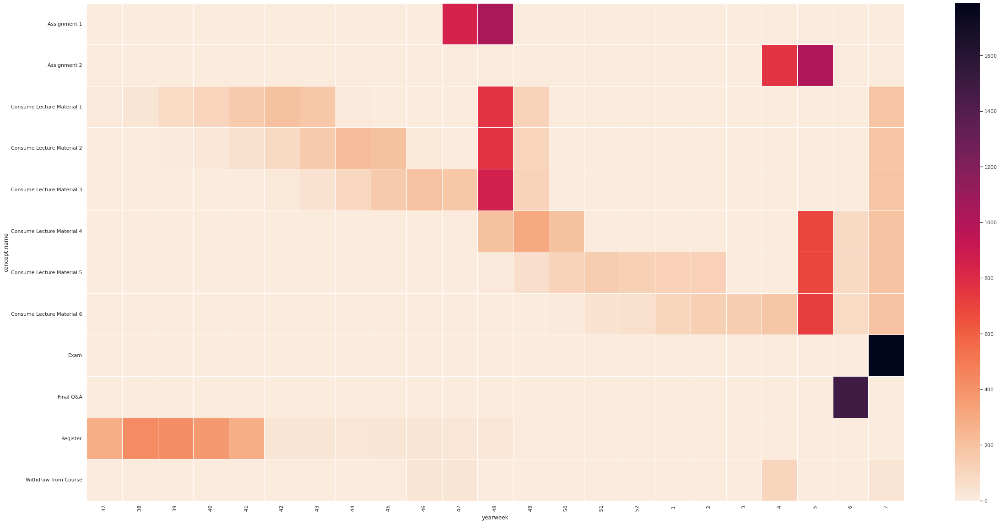

In [64]:
activity = df[["case:concept:name","concept:name"]]
activity_df = pd.DataFrame(data=activity)
activity_df.loc[:,'yearweek'] = df['time:timestamp'].dt.isocalendar().week
activity_df_grouped = activity_df.groupby(["yearweek", "concept:name"]).count().reset_index()
activity_df_grouped['yearweek'] =[(""+str(i)) if i<10 else (" "+str(i)) for i in activity_df_grouped['yearweek']]
activity_df_wide = activity_df_grouped.pivot("concept:name","yearweek", "case:concept:name").fillna(0)

# Draw a heatmap with the numeric values in each cell
fig, ax = plt.subplots(figsize=(40, 20))
sns.heatmap(activity_df_wide, annot=False, fmt="f", linewidths=.5, ax=ax, linecolor='white', cmap='rocket_r')
# For longer ticks it is sometimes helpful to rotate them
ax.tick_params(axis='x', labelrotation=90)

```We can see that the registration period lasts for about 5 weeks, with a peak between the second and third week. The material of lectures 1, 2, 3 is consumed linearly from the third week. In the same week as Assignment 1 the consumption activities of the material of lessons 1, 2, 3 have a considerable increase occurring more than 800 times each. In the following weeks there is a linear consumption of the material of lessons 4, 5, 6, registering again a peak, of the same intensity of the first, near Assignment 2. We see how the Q&A activity was carried out by most of the students. Finally, we can notice a general consumption of the material of all the lessons in the same week of the exam. It's possible to distinguish a ramp pattern.```

**b)** Can you relate the patterns that you observe in the heatmap to the process models that you discovered in question **Q5 - f)**?

*Hint: In contrast to the other questions, this question is deliberately less explicit. You may approach it having the following question in mind: \
Is there a pattern in the heatmap that explains why a certain process model shows a certain behavior/control flow?*

```From exercise Q5-f) we have seen from the process model of the log base that there is no order in the consumption of lesson material. The reason could be clarified by the heatmap in which we notice that if initially the material consumption activities follow one another in order, near the two Assignments we have two peaks involving lessons 1, 2, 3 for Assignment 1 and lessons 4,5,6 for Assignment 2. Another peak is then present near the exam and involves the material consumption activities of all the lessons.```

### Process Flow

**c)** Assume that another process analyst also had access to the event log. 
Given the data, he created the following novel entities:
- 'Block 1 Complete': The participant downloaded the entire material of the first lecture block (materials 1, 2, and 3). (Not considering when he downloaded it)
- 'Block 1 Incomplete': The participant did not download the entire material of the first lecture block
- 'Block 2 Complete': See 'Block 1 Complete'
- 'Block 2 Incomplete': See 'Block 1 Incomplete'
- 'Ass 1 Excellent': Participant scored at least 85 points in the first part of the assignment
- 'Ass 1 Not Excellent': Participant scored less than 85 points in the part of the assignment
- 'Ass 2 Not Excellent', 'Ass 2 Excellent', 'Exam Not Excellent', 'Exam Excellent': Similar to 'Ass 1 Excellent' and 'Ass 1 Not Excellent'
- 'Withdraw': Participant dropped the course

Based on the entities he derived a set of flow, for example, the flow between 'Block 1 Complete' and 'Ass 1 Excellent' describes how often a partipant who consumed the first lecture block scored excellent in the first part of the assignment.

The next cell loads the entities and flows for you. The flows are stored as a dictionary following the pattern:

    (source, target): flow_value
    
where source and target are indices into the entities list.

Create a **Sankey diagram** that visulizes these flows. Please use `plotly.graph_object.Sankey` to create the diagram.

Briefly **describe** your results.
Moreover, **discuss** this visualization considering your knowlege from the Process Mining task.

*Hint: Having a look at the Sankey diagram will make the analyst's idea behind the entities much clearer.*

In [65]:
with open('./dataset/sankeyEntities.pkl', 'rb') as f:
    entities = pickle.load(f)
with open('./dataset/sankeyFlows.pkl', 'rb') as f:
    flows = pickle.load(f)

In [66]:
import plotly.graph_objects as go
print (flows)
print(entities)
l_source = [0, 2, 3, 2, 4, 6, 8, 3, 6, 7, 0, 1, 3, 5, 7, 2, 8, 4, 7]
l_target = [2, 3, 11, 4, 6, 8, 10, 6, 7, 9, 1, 3, 5, 7, 10, 11, 9, 11, 11]
l_labels = ['Register', 'Block 1 Incomplete', 'Block 1 Complete', 'Ass 1 Not Excellent', 'Ass 1 Excellent', 'Block 2 Incomplete', 'Block 2 Complete', 'Ass 2 Not Excellent', 'Ass 2 Excellent', 'Exam Not Excellent', 'Exam Excellent', 'Withdraw']
l_values = [1766, 1151, 99, 497, 495, 506, 370, 1056, 1043, 1097, 142, 139, 143, 143, 123, 64, 136, 2, 35] 

# Define Sankes diagram
fig = go.Figure(data=[go.Sankey(
    node = dict(
      pad = 15,
      thickness = 20,
      line = dict(color = "black", width = 0.5),
      label = l_labels,
      #color = "blue"
    ),
    link = dict(
      source = l_source,
      target = l_target,
      value = l_values
  ))])

fig.update_layout(title_text="Sankey Diagram", font_size=10)
fig.show()

defaultdict(<class 'int'>, {(0, 2): 1766, (2, 3): 1151, (3, 11): 99, (2, 4): 497, (4, 6): 495, (6, 8): 506, (8, 10): 370, (3, 6): 1056, (6, 7): 1043, (7, 9): 1097, (0, 1): 142, (1, 3): 139, (3, 5): 143, (5, 7): 143, (7, 10): 123, (2, 11): 64, (8, 9): 136, (4, 11): 2, (7, 11): 35})
['Register', 'Block 1 Incomplete', 'Block 1 Complete', 'Ass 1 Not Excellent', 'Ass 1 Excellent', 'Block 2 Incomplete', 'Block 2 Complete', 'Ass 2 Not Excellent', 'Ass 2 Excellent', 'Exam Not Excellent', 'Exam Excellent', 'Withdraw']


```Among all those who do not complete block 1, none have an excellent grade on assignment 1.
Among all the students who complete block 1 (1770), 65% (1150) do not have an excellent mark in assignment 1, 3.6% (64) drop out and the rest get an excellent mark in the first assignment.
Practically all the students who obtained an excellent mark in the first assignment complete block 2.
Of those who did not obtain an excellent mark in assignment 1, 77% (1006) complete block 2, 11% (143) do not complete it and the remainder withdraw.
Among all the students who completed block 2 (1550) only 32% obtained an excellent grade in assignment 2, all the rest failed to obtain an excellent grade. No student withdraws from the course after completing block 2.
Students who did not obtain an excellent mark in Assignment 1 and who do not complete Block 2 will not obtain an excellent mark in Assignment 2 either.
The majority of students who obtained an excellent grade in assignemnt 2 (73%) will also obtain an excellent grade in the exam.
In contrast, the majority of students who did not receive an excellent mark in assignemnt 2 (87%) will not get an excellent mark in the exam.
There is a small percentage of students who did not obtain an excellent mark in assignment 2 who decide to withdraw.```

# Question 6 - Big Data (15 points) 

### Problem Description
You are working at a finance company that makes loans to individuals and businesses. As a process analyst in *business intelligence team*, you are expected to deliver data-driven insights to improve business processes of the company. Recently, your boss asked you to discover a comprehensive process model of 10 international branches using your big data skills. Your colleague already tried it using commercial on-premise tools, but, due to the immense size of the data, he didn't manage to even load the data to the tool. You are planning to 1) load the datasets from 10 different branches to Hadoop Distributed File System (HDFS), 2) preprocess them using HDFS, and 3) use MapReduce programming model to discover a comprehensive process model. 

### Preparation
The preparation of this problem consists of two steps:

**Preparation step 1**: Replace the filepath to your own filepath to produce the **LoanApplication.csv**.  

In [67]:
import pandas as pd
filepath = "./dataset/LoanApplication.csv"
original_log = pd.read_csv(filepath,sep=",")
original_log.head()

,eventID,CaseID,Activity,Timestamp,LoanGoal,ApplicationType,RequestedAmount,Action,FirstWithdrawalAmount,Accepted,NumberOfTerms,OfferID,org:resource,MonthlyCost,EventOrigin,EventID,Selected,CreditScore,OfferedAmount,Duration
0,661035,Application_1000086665,A_Create Application,18601566,"Other, see explanation",New credit,5000.0,Created,NaN,NaN,NaN,NaN,User_1,NaN,Application,Application_1000086665,NaN,NaN,NaN,0
1,661036,Application_1000086665,A_Submitted,18601566,"Other, see explanation",New credit,5000.0,statechange,NaN,NaN,NaN,NaN,User_1,NaN,Application,ApplState_161925113,NaN,NaN,NaN,0
2,661040,Application_1000086665,A_Concept,18601632,"Other, see explanation",New credit,5000.0,statechange,NaN,NaN,NaN,NaN,User_1,NaN,Application,ApplState_385184570,NaN,NaN,NaN,0
3,661041,Application_1000086665,W_Complete application,18679694,"Other, see explanation",New credit,5000.0,Obtained,NaN,NaN,NaN,NaN,User_14,NaN,Workflow,Workitem_518019192,NaN,NaN,NaN,0
4,661043,Application_1000086665,A_Accepted,18767152,"Other, see explanation",New credit,5000.0,statechange,NaN,NaN,NaN,NaN,User_5,NaN,Application,ApplState_856156982,NaN,NaN,NaN,0


**Preparation step 2**: In this question, we generate 10 event logs based on the ``original_log``. For randomization, you need to use the sum of the group's matriculation numbers (e.g., a group with 3 students having "100000", "100001", and "100002" as their matriculation numbers will use "300003" for the randomization).

In [68]:
# Below are GIVEN utility functions (do not modify):
import random
import os
def _ramdomize(x):
    random_val = random.randint(5,10)
    return x+random_val

def _randomize_log(log,matriculation_num):
    """Randomize case attributes based on the matriculation number

    Keyword arguments:
    log -- event log
    matriculation_num - sum of matriculation numbers
    """
    attribute_cols = ["Duration"]
    random.seed(matriculation_num)
    for attr in attribute_cols:
        log[attr] = log[attr].apply(_ramdomize)
    return log

def _extract_log(log,iter_num):
    """Extract n-th log to ./generated_logs/

    Keyword arguments:
    log -- event log
    iter_num -- n-th iteration
    """
    log.to_csv("./generated_logs/generated_log-{}.tsv".format(iter_num),header=False,index=False, sep="\t",line_terminator="")

def generate_log(original_log,num_replication,mat_num):
    """Generate logs (randomized by the matriculation number and extracted to ./generated_logs/) 

    Keyword arguments:
    log -- event log
    num_replication -- number of generated logs
    mat_num -- sum of matriculation numbers
    """
    case_col="CaseID"
    timestamp_col = "Timestamp"
    dir_path = "./generated_logs"
    try:
        os.mkdir(dir_path)
    except OSError:
        print ("Directory already exists: %s" % dir_path)
    else:
        print ("Successfully created the directory %s " % dir_path)
    
    for i in range(num_replication):
        print("starts {}".format(i))
        generated_log = original_log.copy(deep=True)
        generated_log[case_col] = str(i) + generated_log[case_col]
        generated_log[timestamp_col] = generated_log[timestamp_col].apply(str).str.zfill(10)
        randomized_log = _randomize_log(generated_log,mat_num)
        _extract_log(randomized_log,i)
        print ("Successfully created %i th log at %s "% (i,dir_path))

Replace the SUM_MAT_NUM to yours to generate logs.

In [69]:
SUM_MAT_NUM = 378329
NUM_REPITITION=10
generate_log(original_log,NUM_REPITITION,SUM_MAT_NUM)

Directory already exists: ./generated_logs
starts 0
Successfully created 0 th log at ./generated_logs 
starts 1
Successfully created 1 th log at ./generated_logs 
starts 2
Successfully created 2 th log at ./generated_logs 
starts 3
Successfully created 3 th log at ./generated_logs 
starts 4
Successfully created 4 th log at ./generated_logs 
starts 5
Successfully created 5 th log at ./generated_logs 
starts 6
Successfully created 6 th log at ./generated_logs 
starts 7
Successfully created 7 th log at ./generated_logs 
starts 8
Successfully created 8 th log at ./generated_logs 
starts 9
Successfully created 9 th log at ./generated_logs 


### 6.1. Hadoop Distributed File System (HDFS)

Now, it's time to work with the Hadoop Distributed File System (HDFS). The goal of this task is to merge 10 event logs at your disk using HDFS. Follow the instructions below and show your results in each step (screenshots of the command line). We use "letter identifier" for this task (The letter identifier is the string consisting of the first letters of the group memebers' first names, e.g., for the group with "Antonio Rüdiger", "Bernd Leno", "Christian Günter", the indentifier is "ABC").

    1) Import the event logs to your Docker engine (at /usr/local/hadoop/(identifier)-generated-logs/).
    2) Upload the event logs to the running HDFS (at /input/(identifier)-generated-logs/). 
    3) Merge all the files and copy the result back to HDFS (at /input/(identifier)-final-log-10.tsv).
    4) Merge 6 files (you can randomly select) and copy the result back to HDFS (at /input/(identifier)-final-log-6.tsv).
    5) Merge 2 files (you can randomly select) and copy the result back to HDFS (at /input/(identifier)-final-log-2.tsv).
    6) Print out the completely-merged event log from 3), i.e., "(identifier)-final-log-10.tsv", in the command line (the screenshot may contain 10 rows).

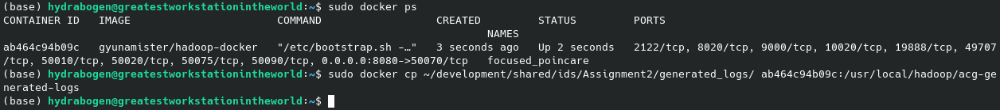

In [70]:
from IPython.display import Image
# This is task 1)
Image(filename='./results/a1.png')

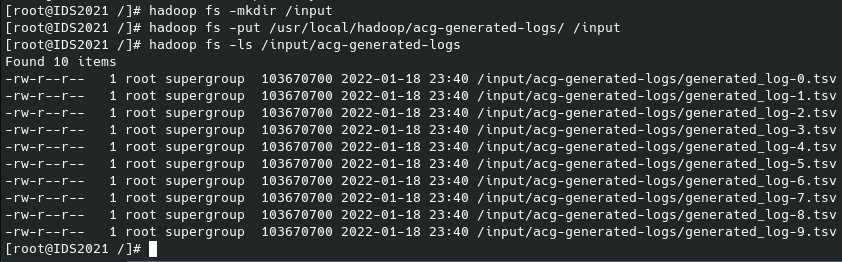

In [71]:
# This is task 2)
Image(filename='./results/a2.png') 

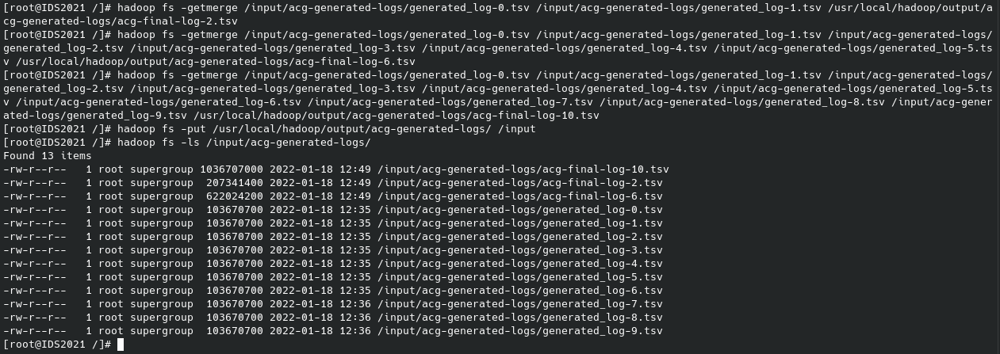

In [72]:
# This is task 3-5)
Image(filename='./results/a3.png') 

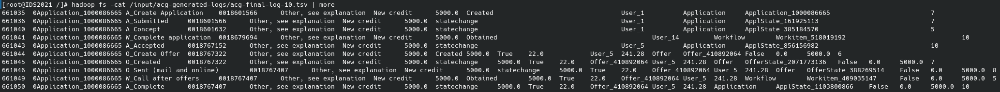

In [73]:
# This is task 6
# If the image is blurry, view it in full screen. The quality is not the problem, but Jupyers range of display.
display(Image(filename='./results/a4.png'))

### 6.2. Process Discovery

Discover a process model from the completely merged event log using MapReduce algorithms. Explain how you discover the process model with the following deliverables:

    1) Mapper function (as python file(s))
    2) Reducer function (as python file(s))
    3) Hadoop commands for MapReduce computation (as text file)
    4) Jupyter notebook script that visualize (1) a directly-follows graph and (2) a Petri net  based on the computed directly-follows relations.

<font color='red'>Important!</font> Please note that in this task, your result will be evaluated based on whether they are reproducible from your explanation. If you skip MapReduce computations for this task, you will get 0 points.The deliverables of 1), 2), and 3) should be submitted as outputs. 

In [74]:
# Directly follows graph
# 1. Import libraries
import csv
from pm4py.objects.conversion.dfg import converter as dfg_mining
from pm4py.visualization.dfg import visualizer as dfg_visualization

# 2. preprocessing
with open('./output/log-10-pm/part-00000') as file:
    file_reader = csv.reader(file, delimiter='\t')
    dfg = dict()
    for row in file_reader:
        _from, _to = row[0].split(',')
        rel = (_from, _to)
        freq = int(row[1])
        dfg[rel] = freq
# 3. Visualize Directly-follows-graph (DFG)
gviz_dfg = dfg_visualization.apply(dfg, parameters={"bgcolor": "white"})
dfg_visualization.save(gviz_dfg, "./output/dfg.png")

# 4. Discover and Visualize Petri-Net
net, im, fm = dfg_mining.apply(dfg)
gviz_petri = pn_visualizer.apply(net, im, fm, parameters={"bgcolor": "white"})
dfg_visualization.save(gviz_petri, "./output/petri.png")

hadoop jar /usr/local/hadoop/share/hadoop/tools/lib/hadoop-streaming-2.10.1.jar \
-files /input/functions/pm_mapper1.py,/input/functions/pm_reducer1.py \
-mapper "python pm_mapper1.py" \
-reducer "python pm_reducer1.py" \
-input /input/acg-generated-logs/acg-final-log-10.tsv \
-output /output/partial-pm

hadoop jar /usr/local/hadoop/share/hadoop/tools/lib/hadoop-streaming-2.10.1.jar \
-files /input/functions/pm_mapper2.py,/input/functions/pm_reducer2.py \
-mapper "python pm_mapper2.py" \
-reducer "python pm_reducer2.py" \
-input /output/partial-pm/part-00000 \
-output /output/log-10-pm

hadoop fs -copyToLocal /output /usr/local/hadoop 



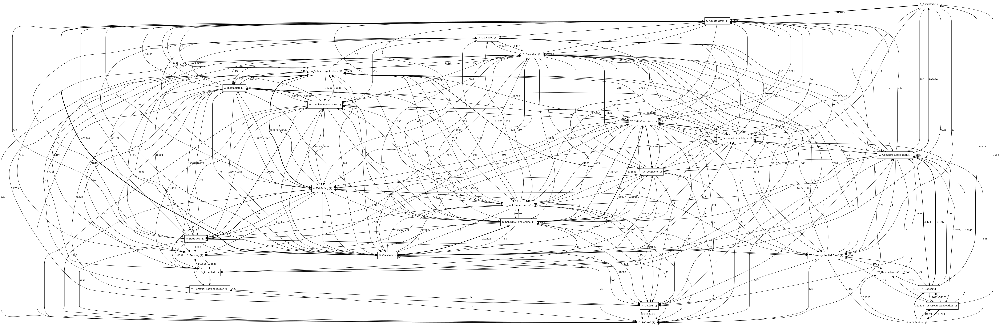

In [75]:
from pygments import highlight
from pygments.lexers import PythonLexer
from pygments.formatters import HtmlFormatter
from IPython.display import HTML

formatter = HtmlFormatter()

# displays
with open("./functions/pm_mapper1.py") as file:
    display(HTML('<style type="text/css">{}</style>{}'.format(
        formatter.get_style_defs('.highlight'),
        highlight(file.read(), PythonLexer(), formatter))))

with open("./functions/pm_mapper2.py") as file:
    display(HTML('<style type="text/css">{}</style>{}'.format(
        formatter.get_style_defs('.highlight'),
        highlight(file.read(), PythonLexer(), formatter))))

with open("./functions/pm_reducer1.py") as file:
    display(HTML('<style type="text/css">{}</style>{}'.format(
        formatter.get_style_defs('.highlight'),
        highlight(file.read(), PythonLexer(), formatter))))

with open("./functions/pm_reducer2.py") as file:
    display(HTML('<style type="text/css">{}</style>{}'.format(
        formatter.get_style_defs('.highlight'),
        highlight(file.read(), PythonLexer(), formatter))))

with open("./functions/hadoop1.txt") as file:
    print(file.read())

dfg_visualization.view(gviz_dfg)
pn_visualizer.view(gviz_petri)


### 6.3. Performance Analysis

a) Compute the total service time for each case based on MapReduce algorithms using the completely-merged event log (i.e., (identifier)-final-log-10.tsv) and visualize 100 cases that show the longest total service time using any chart.
    
The deliverables of 1), 2), 3) and 4) should be submitted as outputs:
```
1) Mapper function (as python file(s))
2) Reducer function (as python file(s))
3) Hadoop commands for MapReduce calculation (as text file)
4) Result: total service times for cases (as text file)
```

b) Compare the (approximate) computation time of the service time calculation between 1. the completely-merged event log (i.e., (identifier)-final-log-10.tsv), 2. 6-merged event log (i.e., (identifier)-final-log-6.tsv), and 3. 2-merged event log (i.e., (identifier)-final-log-2.tsv). Interpret the difference (e.g., the computation time scales linearly with the increasing number of events).

In [76]:
# a)
import json
with open('./output/log-10-pa/part-00000') as file:
    file_reader = csv.reader(file, delimiter='\t')
    stime = dict()
    log_10_time = 0
    rows = 0
    for row in file_reader:
        id = row[0]
        time = int(row[1])
        stime[id] = time
long_cases = sorted(stime.items(), key=lambda item: item[1], reverse=True)[:100]


hadoop jar /usr/local/hadoop/share/hadoop/tools/lib/hadoop-streaming-2.10.1.jar \
-files /input/functions/pa_mapper.py,/input/functions/pa_reducer.py \
-mapper "python pa_mapper.py" \
-reducer "python pa_reducer.py" \
-input /input/acg-generated-logs/acg-final-log-10.tsv \
-output /output/log-10-pa

hadoop fs -copyToLocal /output /usr/local/hadoop
 



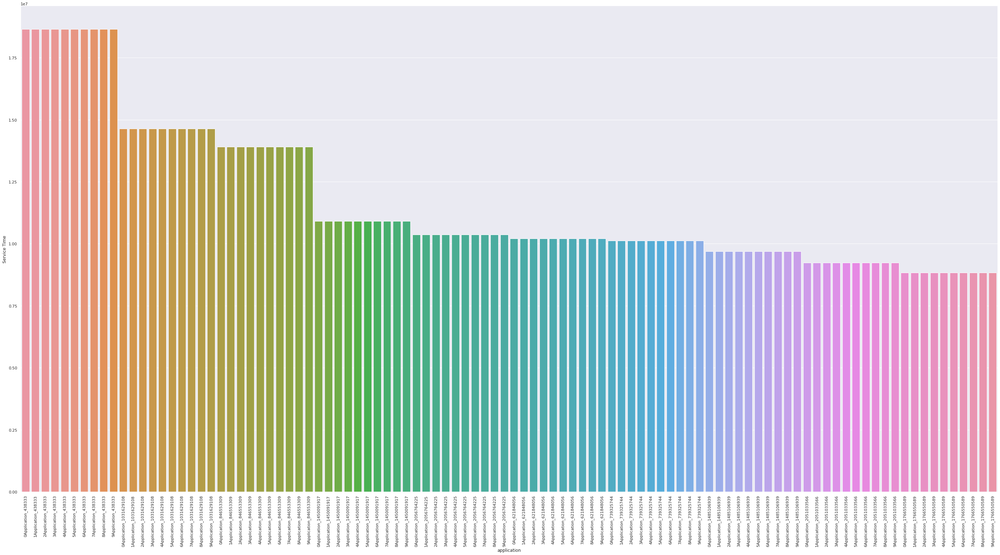

In [77]:
with open("./functions/pa_mapper.py") as file:
    display(HTML('<style type="text/css">{}</style>{}'.format(
        formatter.get_style_defs('.highlight'),
        highlight(file.read(), PythonLexer(), formatter))))

with open("./functions/pa_reducer.py") as file:
    display(HTML('<style type="text/css">{}</style>{}'.format(
        formatter.get_style_defs('.highlight'),
        highlight(file.read(), PythonLexer(), formatter))))

with open("./functions/hadoop2.txt") as file:
    print(file.read())

fig = sns.catplot(data=pd.DataFrame(long_cases, columns=["application", "Service Time"]), x="application", y="Service Time", kind="bar", height=20, aspect=2)
fig.set_xticklabels(rotation=90)
display()

b)
```
Using the "time" command on :
hadoop jar /usr/local/hadoop/share/hadoop/tools/lib/hadoop-streaming-2.10.1.jar \
-files /input/functions/pa_mapper.py,/input/functions/pa_reducer.py \
-mapper "python pa_mapper.py" \
-reducer "python pa_reducer.py" \
-input /input/acg-generated-logs/acg-final-log-10.tsv \
-output /output/log-10-pa

hadoop jar /usr/local/hadoop/share/hadoop/tools/lib/hadoop-streaming-2.10.1.jar \
-files /input/functions/pa_mapper.py,/input/functions/pa_reducer.py \
-mapper "python pa_mapper.py" \
-reducer "python pa_reducer.py" \
-input /input/acg-generated-logs/acg-final-log-6.tsv \
-output /output/log-6-pa

hadoop jar /usr/local/hadoop/share/hadoop/tools/lib/hadoop-streaming-2.10.1.jar \
-files /input/functions/pa_mapper.py,/input/functions/pa_reducer.py \
-mapper "python pa_mapper.py" \
-reducer "python pa_reducer.py" \
-input /input/acg-generated-logs/acg-final-log-2.tsv \
-output /output/log-2-pa

we got the following results:
log-10:
    real    0m21.752s
    user    0m29.949s
    sys     0m1.812s
log-6:
    real    0m13.786s
    user    0m20.486s
    sys     0m1.162s
log-2:
    real    0m6.792s
    user    0m10.773s
    sys     0m0.766s

To analyze the computation time we focus on the real-time. We can observe the following behavior:
Log 6 is 3 times bigger than log 2, however, the computation time only increased by a factor of 2. Similarly, the computation time of log 10 is 3.2 times slower than the case of log 2, while being 5 times bigger in size. This distinction is still noticeable for lower multiples, for example, log 10 is 1.7 times bigger than log 6 with an increase of 1.6 in the computation time.
The computation time seems to scale linearly with increasing size, with a factor of roughly 0.66. i.e. if you increase the dataset by x percent, it will take 0.66x percentage longer to compute (on average). The only outlier to this is the difference between log-10 and log-6, which we assume to be an outlier.
```